In [1]:
import numpy as np
import scipy as sp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.svm import SVR

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

import xgboost as xgb
import lightgbm as lgb

from combat.pycombat import pycombat
import umap
import joblib

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [365]:
# Dataset
methane_data = pd.read_csv('wallace_metadata.csv')
methane_label = methane_data.iloc[:, -1]
methane_data = methane_data.iloc[:, 1:-1]
herd_data = methane_data.iloc[:,5:10]
methane_data = methane_data.drop(methane_data.columns[5:10], axis=1)

# Preprocessing

In [20]:
methane_data.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
count,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,...,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000
mean,23.024394,21.439051,3.746856,7.338955,1.061491,0.005298,0.004444,0.004464,0.001216,-0.001197,...,-0.000825,-0.000050,0.000036,-0.001126,-0.000858,-0.000577,0.000378,-0.000870,-0.000771,-0.001126
std,4.625881,4.330192,0.832760,1.507706,0.361301,0.654090,0.696133,0.692277,0.726796,0.713689,...,0.709234,0.746731,0.750689,0.702712,0.718932,0.699794,0.760520,0.723022,0.714202,0.703128
min,13.049624,11.848343,1.914402,3.971343,0.441228,-1.482020,-1.506578,-1.223002,-1.174050,-0.523653,...,-1.030134,-1.155412,-1.162081,-1.256359,-1.040988,-1.952825,-1.584498,-0.836781,-0.425195,-0.288872
25%,19.695783,18.344916,3.140629,6.239734,0.781763,-0.462066,-0.490756,-0.447295,-0.460534,-0.494901,...,-0.481837,-0.488590,-0.493751,-0.511368,-0.459047,-0.455090,-0.548701,-0.521357,-0.412996,-0.288220
50%,22.845651,21.261001,3.688633,7.219139,0.977494,-0.117523,-0.095323,-0.117204,-0.155080,-0.282421,...,-0.196913,-0.169199,-0.116336,-0.081620,-0.174544,-0.046500,-0.024274,-0.163732,-0.134417,-0.239868
75%,26.157100,24.295937,4.303517,8.290428,1.302917,0.378923,0.434030,0.288418,0.296445,0.150090,...,0.375887,0.389475,0.352925,0.386803,0.327261,0.405180,0.492375,0.380358,-0.080833,-0.069388
max,36.480065,34.056463,6.428222,12.606810,2.158659,2.592842,3.207008,4.148220,5.416660,4.256504,...,2.874140,3.810887,3.553038,3.264837,3.447357,2.956070,3.322926,3.936159,4.991033,5.808322


In [ ]:
# count the amount of negative nnumber in each column
methane_data.lt(0).sum().to_list()

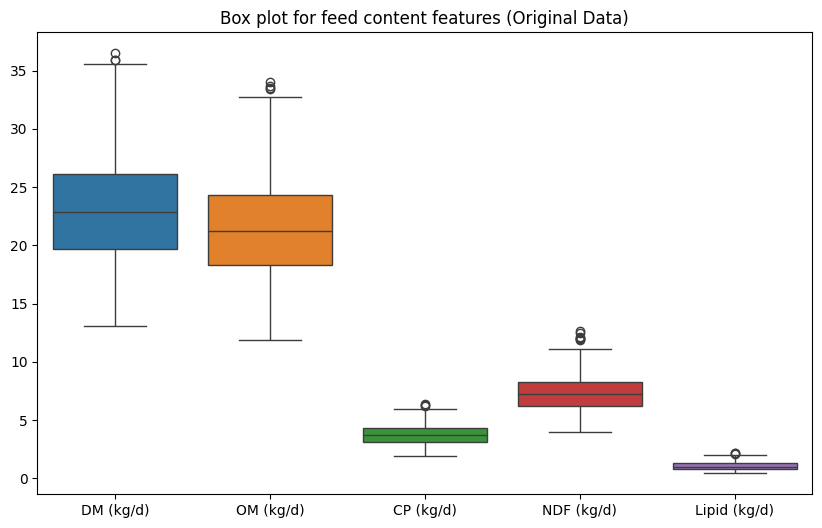

In [42]:
# Box plot for first 5 features (feed information)
plt.figure(figsize=(10, 6))
sns.boxplot(data=methane_data.iloc[:, :5])
plt.title('Box plot for feed content features (Original Data)')
plt.show()

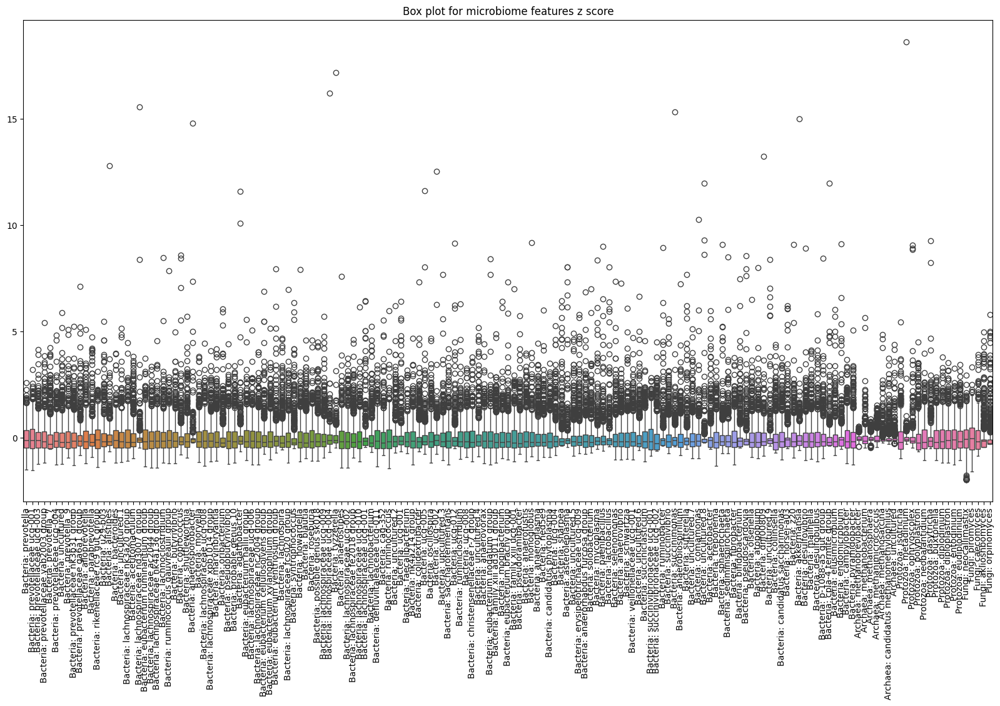

In [43]:
# Box plot for microbiome features z score
plt.figure(figsize=(20, 10))
sns.boxplot(data=methane_data.iloc[:, 5:])
plt.title('Box plot for microbiome features z score')
plt.xticks(rotation=90)
plt.show()

A lot of outliers in the microbiome features

In [12]:
pos_min_max_scaler = MinMaxScaler((0, 1))
neg_min_max_scaler = MinMaxScaler((-1, 1))
z_score_scaler = StandardScaler()
robust_scaler = RobustScaler()

min_max_data = methane_data.copy()
min_max_data.iloc[:, :5] = pos_min_max_scaler.fit_transform(methane_data.iloc[:, :5])
min_max_data.iloc[:, 5:] = neg_min_max_scaler.fit_transform(methane_data.iloc[:, 5:])
z_score_data = z_score_scaler.fit_transform(methane_data)
robust_data = robust_scaler.fit_transform(methane_data)

# min_max_data = pd.DataFrame(min_max_data, columns=methane_data.columns)
z_score_data = pd.DataFrame(z_score_data, columns=methane_data.columns)
robust_data = pd.DataFrame(robust_data, columns=methane_data.columns)

In [23]:
min_max_data

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
0,0.311544,0.318076,0.280877,0.369673,0.221724,0.014735,0.116783,-0.503009,0.060527,-0.945532,...,0.080335,-0.232876,-0.535485,-0.625015,-0.459834,-0.396721,-0.008778,-0.859406,-0.997710,-0.999975
1,0.758497,0.756329,0.643688,0.796589,0.468044,-0.405794,-0.202174,-0.663672,-0.709979,-0.998363,...,-0.310960,-0.662656,-0.537188,-0.523041,-0.645935,-0.332351,-0.352255,-0.886555,0.448494,-0.748459
2,0.359564,0.365161,0.319857,0.415541,0.248188,0.029271,0.375033,-0.394184,-0.548481,-0.953496,...,-0.758712,-0.632461,-0.640308,-0.688364,-0.777488,-0.097234,-0.216787,-0.823799,-0.923266,-0.999787
3,0.478469,0.481752,0.416377,0.529115,0.313718,-0.457493,-0.280101,-0.615832,-0.493883,-0.789914,...,0.349179,-0.081769,-0.284520,-0.154874,-0.224437,-0.359060,-0.240200,-0.841214,-0.891182,-0.999482
4,0.630799,0.631117,0.540030,0.674616,0.397668,-0.437141,-0.347108,-0.809080,-0.638278,-0.819146,...,-0.654015,-0.111601,-0.450645,-0.336396,-0.551926,-0.311887,0.010281,-0.791030,-0.932911,-0.998928
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,0.495981,0.508679,0.527431,0.418290,0.551878,-0.389860,-0.508182,-0.585682,-0.824087,-0.989175,...,-0.361480,-0.662485,-0.416092,-0.657336,0.081439,-0.461988,-0.318101,0.034526,-0.998469,-0.999723
810,0.422263,0.435739,0.456592,0.372637,0.513123,-0.207811,-0.476780,-0.623602,-0.727464,-0.981260,...,0.077639,-0.533977,-0.401702,-0.741190,-0.537094,-0.132307,-0.260947,-0.175549,-0.998844,-0.999740
811,0.377469,0.391372,0.420887,0.317357,0.458486,-0.258372,-0.369033,-0.595743,-0.592234,-0.927762,...,-0.350363,-0.489599,-0.393019,-0.944869,-0.512090,-0.132230,-0.059708,-0.449082,-0.995133,-0.999887
812,0.788383,0.798065,0.796864,0.642707,0.754518,-0.304789,-0.402782,-0.588835,-0.875182,-0.997545,...,-0.008693,-0.737450,-0.442073,-0.860353,-0.085831,-0.325560,-0.163366,-0.478783,-0.884783,-0.999903


In [24]:
min_max_data.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
count,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,...,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000
mean,0.425718,0.431856,0.405965,0.389974,0.361157,-0.270003,-0.358865,-0.542947,-0.643357,-0.781407,...,-0.472727,-0.534719,-0.507068,-0.444734,-0.536520,-0.204608,-0.354090,-0.649729,-0.843277,-0.905614
std,0.197430,0.194982,0.184491,0.174595,0.210373,0.321037,0.295373,0.257773,0.220552,0.298605,...,0.363312,0.300719,0.318418,0.310852,0.320355,0.285113,0.309947,0.302967,0.263727,0.230640
min,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,0.283655,0.292531,0.271661,0.262683,0.198282,-0.499392,-0.568981,-0.711162,-0.783478,-0.987970,...,-0.719130,-0.731461,-0.716516,-0.670445,-0.740688,-0.389787,-0.577865,-0.867828,-0.995495,-0.999786
50%,0.418090,0.423839,0.393067,0.376100,0.312249,-0.330286,-0.401197,-0.588251,-0.690786,-0.899070,...,-0.573175,-0.602838,-0.556429,-0.480342,-0.613914,-0.223318,-0.364137,-0.717973,-0.892627,-0.983926
75%,0.559421,0.560497,0.529289,0.500157,0.501731,-0.086623,-0.176589,-0.437216,-0.553767,-0.718108,...,-0.279753,-0.377852,-0.357384,-0.273130,-0.390310,-0.039293,-0.153579,-0.489984,-0.872840,-0.928005
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [25]:
z_score_data

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
0,-0.578657,-0.583897,-0.678436,-0.116346,-0.663198,0.887479,1.611322,0.155034,3.193430,-0.549980,...,1.523215,1.004355,-0.089299,-0.580314,0.239524,-0.674227,1.114788,-0.692504,-0.585941,-0.409383
1,1.686585,1.665138,1.289326,2.330341,0.508392,-0.423235,0.530812,-0.468627,-0.302256,-0.727015,...,0.445531,-0.425699,-0.094653,-0.252064,-0.341754,-0.448318,0.005923,-0.782169,4.901157,0.681803
2,-0.335283,-0.342264,-0.467023,0.146522,-0.537324,0.932785,2.486174,0.577466,0.430439,-0.576666,...,-0.787644,-0.325228,-0.418703,-0.784230,-0.752654,0.376834,0.443264,-0.574904,-0.303490,-0.408565
3,0.267349,0.256056,0.056469,0.797425,-0.225641,-0.584372,0.266825,-0.282922,0.678143,-0.028507,...,2.263651,1.507146,0.699348,0.933044,0.974776,-0.542055,0.367676,-0.632421,-0.181759,-0.407244
4,1.039388,1.022571,0.727121,1.631303,0.173660,-0.520939,0.039828,-1.033066,0.023043,-0.126464,...,-0.499293,1.407883,0.177306,0.348735,-0.048122,-0.376499,1.176317,-0.466679,-0.340084,-0.404838
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,0.356105,0.394241,0.658787,0.162280,0.907140,-0.373574,-0.505829,-0.165886,-0.819951,-0.696224,...,0.306393,-0.425128,0.285888,-0.684352,1.930165,-0.903287,0.116186,2.259900,-0.588822,-0.408289
810,-0.017513,0.019929,0.274580,-0.099364,0.722805,0.193842,-0.399451,-0.313081,-0.381585,-0.669704,...,1.515790,0.002470,0.331107,-0.954273,-0.001795,0.253741,0.300698,1.566082,-0.590243,-0.408362
811,-0.244536,-0.207756,0.080931,-0.416174,0.462930,0.036252,-0.034445,-0.204940,0.231935,-0.490432,...,0.337011,0.150134,0.358394,-1.609905,0.076305,0.254014,0.950367,0.662680,-0.576165,-0.408999
812,1.838051,1.879318,2.120096,1.448430,1.870974,-0.108421,-0.148772,-0.178123,-1.051762,-0.724271,...,1.278018,-0.674567,0.204242,-1.337851,1.407705,-0.424487,0.615725,0.564586,-0.157480,-0.409067


In [6]:
z_score_data.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
count,8.140000e+02,8.140000e+02,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,814.000000,814.000000,814.000000,8.140000e+02,...,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,8.140000e+02,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,814.000000
mean,6.983221e-16,4.189933e-16,-3.491610e-16,-4.888255e-16,1.047483e-16,0.000000,0.000000,0.000000,0.000000,1.309354e-17,...,-1.745805e-17,-3.491610e-17,3.491610e-17,0.000000,3.491610e-17,-8.729026e-18,-3.055159e-17,-1.091128e-18,0.000000,0.000000
std,1.000615e+00,1.000615e+00,1.000615e+00,1.000615e+00,1.000615e+00,1.000615,1.000615,1.000615,1.000615,1.000615e+00,...,1.000615e+00,1.000615e+00,1.000615e+00,1.000615,1.000615e+00,1.000615e+00,1.000615e+00,1.000615e+00,1.000615,1.000615
min,-2.157622e+00,-2.216208e+00,-2.201813e+00,-2.234973e+00,-1.717801e+00,-2.275272,-2.171927,-1.774174,-1.618046,-7.324996e-01,...,-1.452187e+00,-1.548177e+00,-1.549019e+00,-1.787368,-1.447661e+00,-2.791462e+00,-2.085220e+00,-1.156846e+00,-0.594630,-0.409489
25%,-7.200049e-01,-7.149884e-01,-7.284209e-01,-7.295169e-01,-7.746991e-01,-0.714965,-0.711795,-0.652970,-0.635714,-6.921889e-01,...,-6.786300e-01,-6.546409e-01,-6.581824e-01,-0.726551,-6.377106e-01,-6.498954e-01,-7.224233e-01,-7.203207e-01,-0.577538,-0.408562
50%,-3.866354e-02,-4.114347e-02,-6.995804e-02,-7.951770e-02,-2.326278e-01,-0.187890,-0.143403,-0.175857,-0.215181,-3.942850e-01,...,-2.766483e-01,-2.266584e-01,-1.551152e-01,-0.114619,-2.417370e-01,-6.566463e-02,-3.243545e-02,-2.253908e-01,-0.187242,-0.339753
75%,6.776293e-01,6.601655e-01,6.688650e-01,6.314619e-01,6.686231e-01,0.571564,0.617484,0.410426,0.406456,2.121097e-01,...,5.314800e-01,5.219605e-01,4.703758e-01,0.552384,4.566783e-01,5.801797e-01,6.473198e-01,5.275938e-01,-0.112169,-0.097143
max,2.910568e+00,2.915614e+00,3.221836e+00,3.496102e+00,3.038579e+00,3.958376,4.603333,5.989370,7.455702,5.969435e+00,...,4.056110e+00,5.106628e+00,4.735898e+00,4.650513,4.799252e+00,4.227621e+00,4.371472e+00,5.448588e+00,6.993646,8.267375


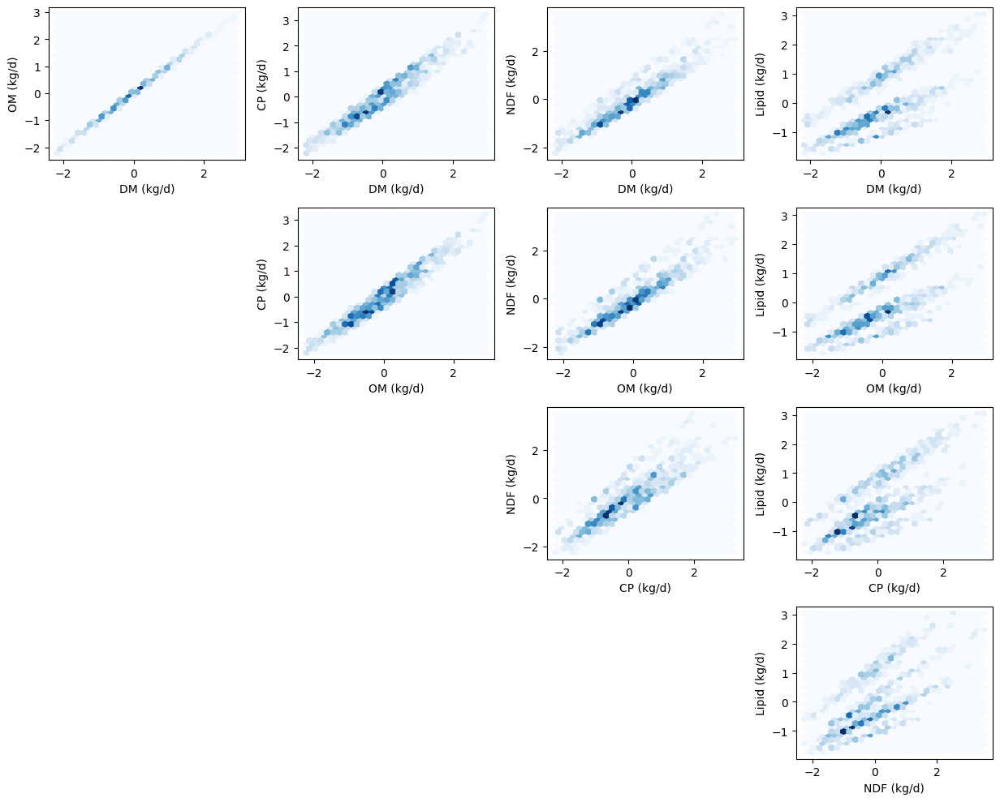

In [37]:
# Hexbin plot for Z score data on feed information
plt.figure(figsize=(15, 10))
for i, feature in enumerate(z_score_data.columns[:5]):
    for j, feature2 in enumerate(z_score_data.columns[:5]):
        if i < j:
            plt.subplot(4, 5, i * 5 + j + 1)
            plt.hexbin(z_score_data[feature], z_score_data[feature2], gridsize=30, cmap='Blues')
            plt.xlabel(feature)
            plt.ylabel(feature2)
plt.tight_layout()
plt.show()

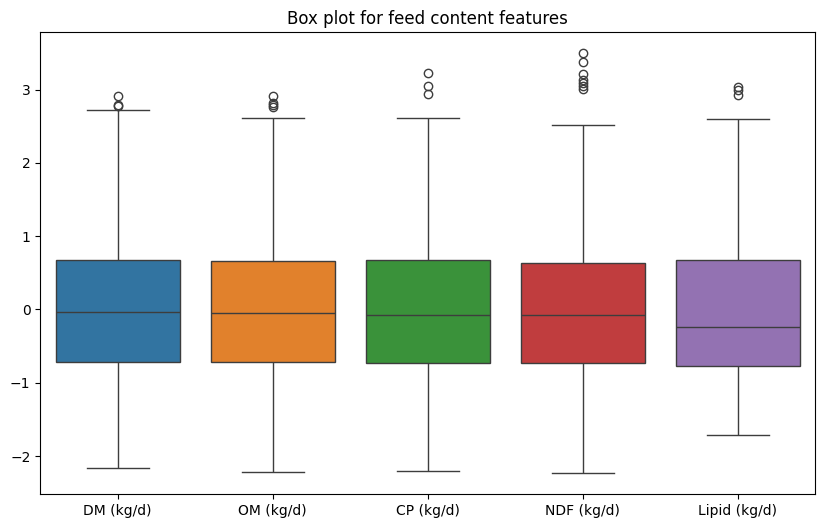

In [29]:
# Box plot for first 5 features of z_score_data using seaborn
plt.figure(figsize=(10, 6))
sns.boxplot(data=z_score_data.iloc[:, :5])
plt.title('Box plot for feed content features')
plt.show()

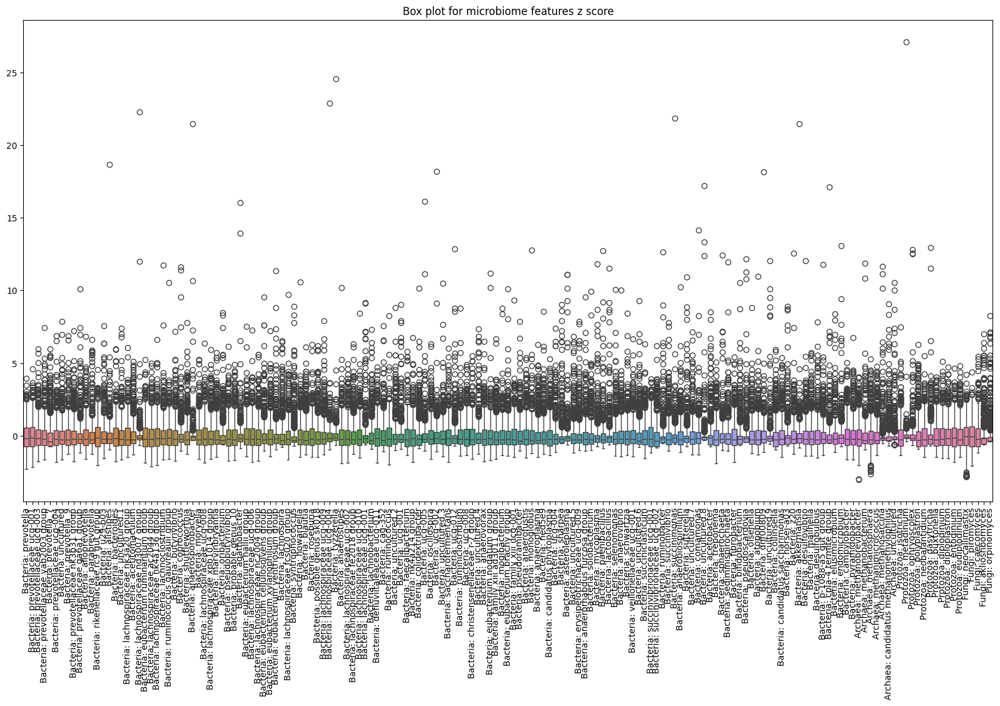

In [30]:
# Box plot for microbiome features z score
plt.figure(figsize=(20, 10))
sns.boxplot(data=z_score_data.iloc[:, 5:])
plt.title('Box plot for microbiome features z score')
plt.xticks(rotation=90)
plt.show()

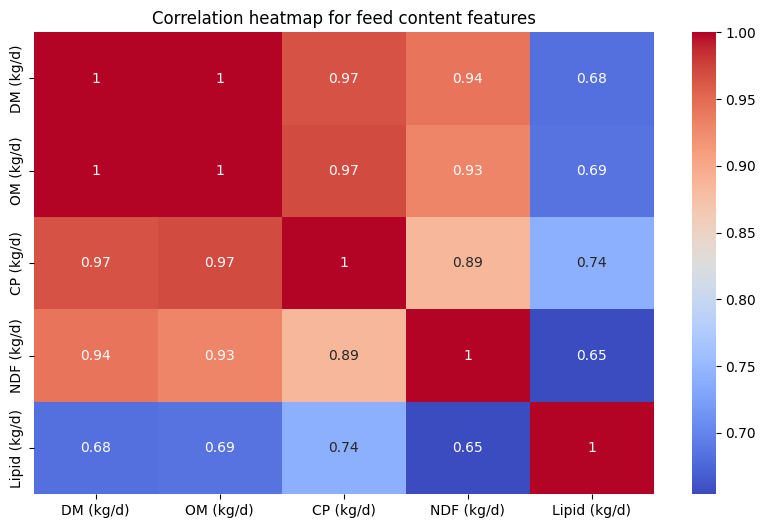

In [36]:
plt.figure(figsize=(10, 6))
sns.heatmap(z_score_data.iloc[:, :5].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation heatmap for feed content features')
plt.show()

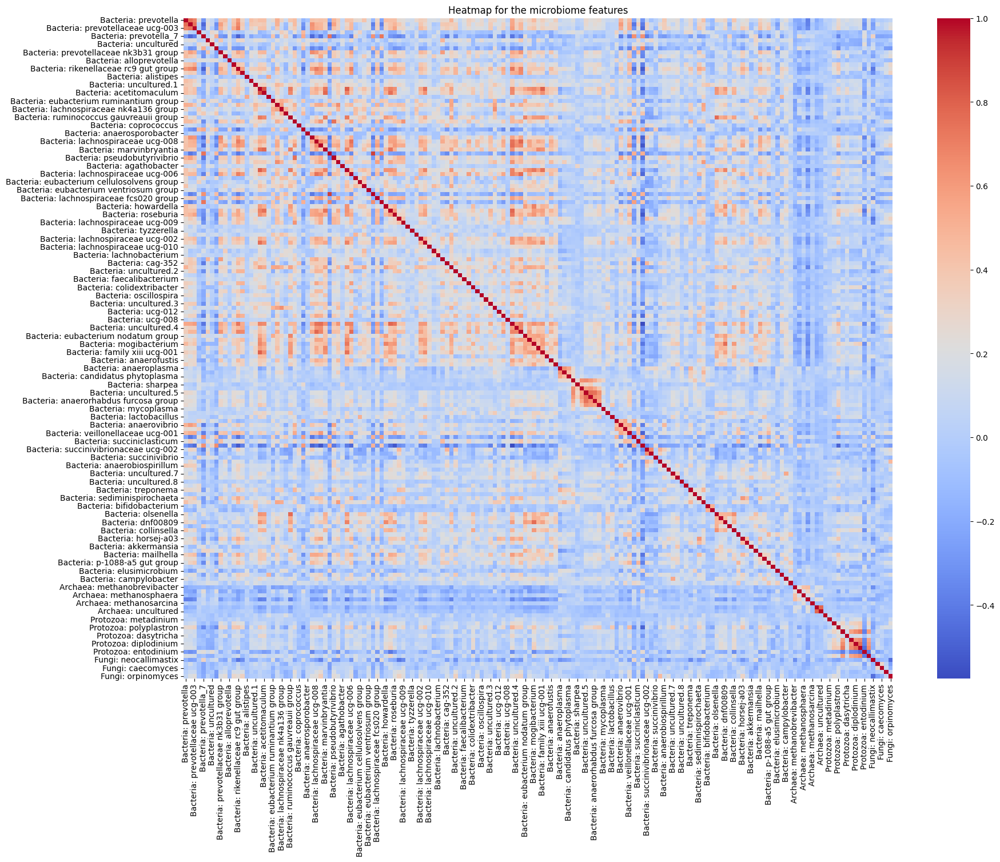

In [38]:
plt.figure(figsize=(20, 15))
sns.heatmap(z_score_data.iloc[:, 5:].corr(), annot=False, cmap='coolwarm')
plt.title('Heatmap for the microbiome features')
plt.show()

In [4]:
robust_data

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
0,-0.386363,-0.394686,-0.435472,-0.027060,-0.298319,0.835869,1.320059,0.311164,3.270684,-0.172172,...,1.487355,1.046245,0.058319,-0.364127,0.439753,-0.494736,0.837547,-0.374315,-0.856738,-0.223591
1,1.234407,1.240793,0.972803,1.770681,0.513413,-0.182930,0.507204,-0.275316,-0.083552,-0.367943,...,0.596788,-0.169166,0.053575,-0.107469,-0.091391,-0.311081,0.028004,-0.446167,10.934108,3.280328
2,-0.212230,-0.218973,-0.284169,0.166086,-0.211108,0.871084,1.978200,0.708413,0.619495,-0.201683,...,-0.422272,-0.083775,-0.233562,-0.523570,-0.466851,0.359733,0.347291,-0.280078,-0.249798,-0.220965
3,0.218951,0.216121,0.090481,0.644347,0.004841,-0.308180,0.308610,-0.100681,0.857176,0.404488,...,2.099230,1.473570,0.757128,0.819168,1.111591,-0.387285,0.292107,-0.326168,0.011782,-0.216722
4,0.771340,0.773524,0.570448,1.257052,0.281495,-0.258874,0.137843,-0.806105,0.228584,0.296164,...,-0.183987,1.389206,0.294554,0.362297,0.176916,-0.252696,0.882467,-0.193353,-0.328433,-0.208998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,0.282455,0.316608,0.521544,0.177664,0.789684,-0.144329,-0.272648,0.009377,-0.580298,-0.333893,...,0.481809,-0.168680,0.390767,-0.445475,1.984580,-0.680953,0.108503,1.991555,-0.862929,-0.220077
810,0.015133,0.044412,0.246577,-0.014583,0.661968,0.296715,-0.192621,-0.129043,-0.159670,-0.304567,...,1.481219,0.194737,0.430835,-0.656526,0.219247,0.259664,0.243208,1.435574,-0.865982,-0.220314
811,-0.147301,-0.121159,0.107987,-0.247363,0.481915,0.174223,0.081968,-0.027349,0.429024,-0.106322,...,0.507110,0.320238,0.455014,-1.169165,0.290611,0.259885,0.717508,0.711644,-0.835730,-0.222357
812,1.342780,1.396543,1.567363,1.122683,1.457472,0.061770,-0.004039,-0.002131,-0.802729,-0.364909,...,1.284732,-0.380680,0.318421,-0.956446,1.507181,-0.291708,0.473198,0.633037,0.063952,-0.222575


In [40]:
robust_data.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotella,Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ucg-003,Bacteria: prevotellaceae yab2003 group,Bacteria: prevotella_7,...,Protozoa: buxtonella,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Protozoa: eudiplodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Fungi: orpinomyces
count,8.140000e+02,8.140000e+02,814.000000,814.000000,814.000000,8.140000e+02,814.000000,8.140000e+02,814.000000,8.140000e+02,...,814.000000,814.000000,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,8.140000e+02,814.000000,8.140000e+02,8.140000e+02
mean,2.766356e-02,2.991918e-02,0.050067,0.058427,0.161175,1.460443e-01,0.107881,1.653734e-01,0.206474,4.360119e-01,...,0.228614,0.192638,1.374454e-01,8.962050e-02,2.208877e-01,0.053383,2.367995e-02,0.180614,4.023504e-01,1.090984e+00
std,7.159347e-01,7.276385e-01,0.716113,0.735217,0.693272,7.777634e-01,0.752751,9.409619e-01,0.960126,1.106509e+00,...,0.826879,0.850428,8.866311e-01,7.823813e-01,9.143137e-01,0.813458,7.305128e-01,0.801830,2.150152e+00,3.213086e+00
min,-1.516104e+00,-1.581688e+00,-1.525711,-1.583754,-1.028997,-1.622492e+00,-1.526034,-1.503030e+00,-1.346100,-3.740077e-01,...,-0.971432,-1.123166,-1.235119e+00,-1.307924e+00,-1.101915e+00,-2.215960,-1.498664e+00,-0.746410,-8.754088e-01,-2.239327e-01
25%,-4.874962e-01,-4.900142e-01,-0.471244,-0.477597,-0.375572,-4.096873e-01,-0.427594,-4.486689e-01,-0.403517,-3.294310e-01,...,-0.332186,-0.363745,-4.457610e-01,-4.784698e-01,-3.618216e-01,-0.474955,-5.037352e-01,-0.396606,-8.386819e-01,-2.209546e-01
50%,-2.749537e-16,2.985080e-16,0.000000,0.000000,0.000000,-8.239937e-18,0.000000,9.432559e-18,0.000000,4.315125e-17,...,0.000000,0.000000,8.239937e-18,7.806256e-18,1.778092e-17,0.000000,1.734723e-18,0.000000,-4.179599e-17,-6.245005e-17
75%,5.125038e-01,5.099858e-01,0.528756,0.522403,0.624428,5.903127e-01,0.572406,5.513311e-01,0.596483,6.705690e-01,...,0.667814,0.636255,5.542390e-01,5.215302e-01,6.381784e-01,0.525045,4.962648e-01,0.603394,1.613181e-01,7.790454e-01
max,2.110160e+00,2.150129e+00,2.355848,2.627242,2.266443,3.222832e+00,3.570913,5.797679e+00,7.360488,7.037189e+00,...,3.580467,4.532790,4.333860e+00,3.725859e+00,4.606213e+00,3.490263,3.215134e+00,4.546769,1.543051e+01,2.763845e+01


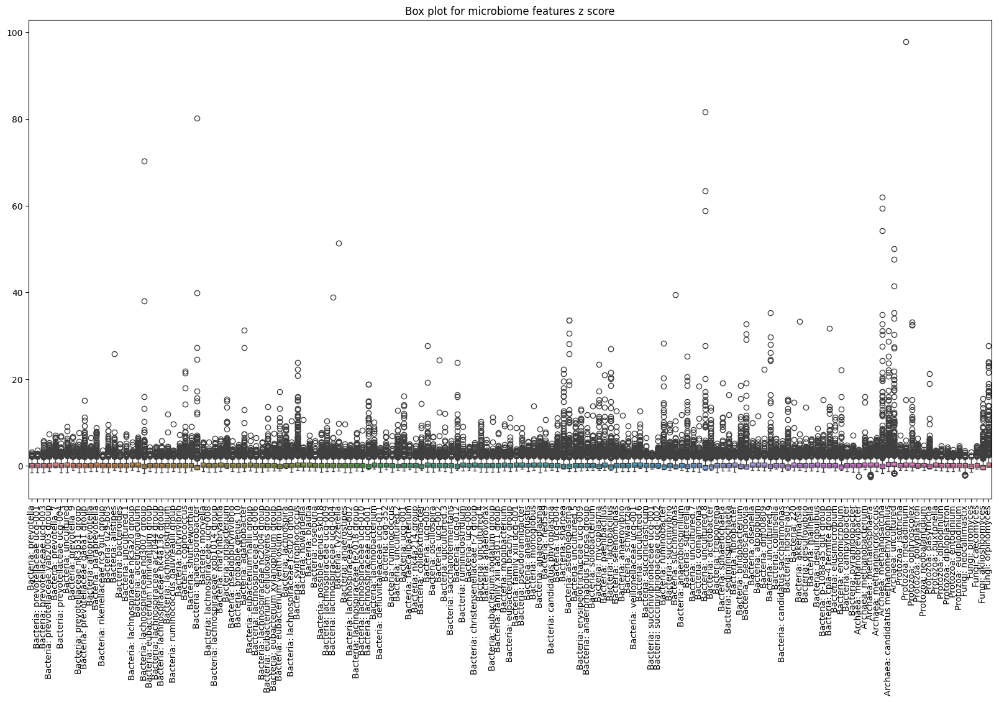

In [47]:
# Looks way worse than z score or original
plt.figure(figsize=(20, 10))
sns.boxplot(data=robust_data.iloc[:, 5:])
plt.title('Box plot for microbiome features z score')
plt.xticks(rotation=90)
plt.show()

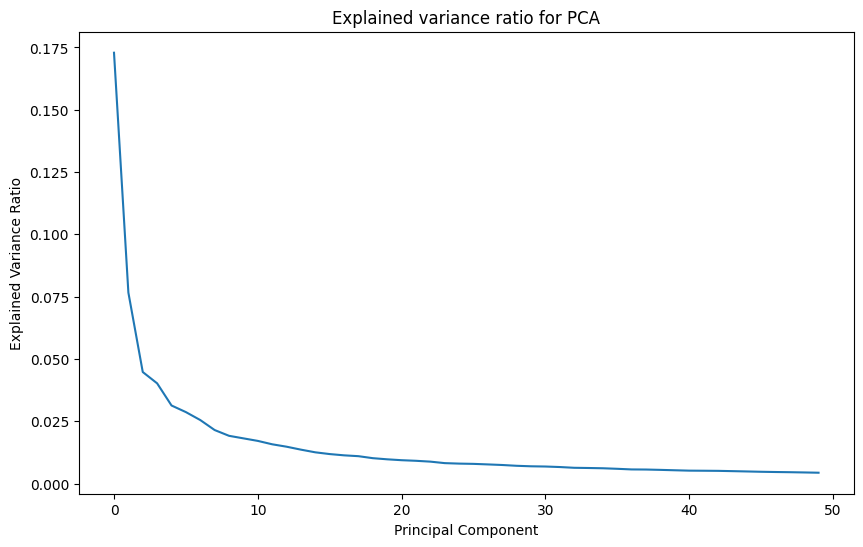

In [11]:
# PCA on the microbiome features
pca = PCA(n_components=50)
pca_data = pca.fit_transform(z_score_data.iloc[:, 5:])
pca_data = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(50)])

# PCA explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(pca.explained_variance_ratio_)
plt.title('Explained variance ratio for PCA')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.show()

/var/folders/dw/pl6xc_k12b5b76vtbdf734jm0000gn/T/ipykernel_79915/2799686212.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  data_tensor = torch.tensor(data, dtype=torch.float32)


Epoch 10, Loss: 1.353684425354004
Epoch 20, Loss: 1.3423457145690918
Epoch 30, Loss: 1.3210550546646118
Epoch 40, Loss: 1.3356069326400757
Epoch 50, Loss: 1.3490015268325806
Epoch 60, Loss: 1.3278357982635498
Epoch 70, Loss: 1.4006198644638062
Epoch 80, Loss: 1.3992747068405151
Epoch 90, Loss: 1.3298592567443848
Epoch 100, Loss: 1.3502877950668335


/var/folders/dw/pl6xc_k12b5b76vtbdf734jm0000gn/T/ipykernel_79915/2799686212.py:61: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(encoded_data_np[:, 0], encoded_data_np[:, 1], s=20, cmap='viridis')


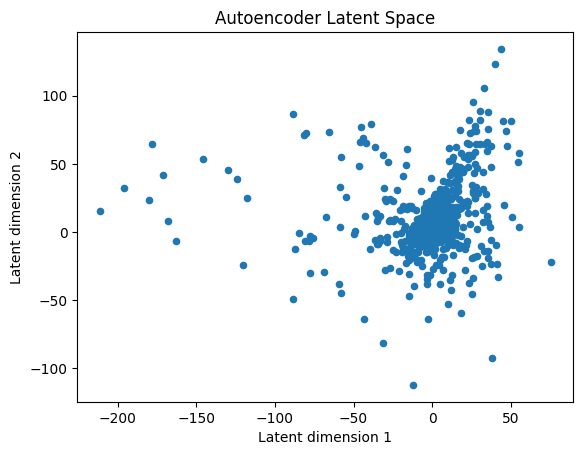

In [20]:
# Autoencoder
device = "mps" if torch.backends.mps.is_available() else "cpu"
data = torch.FloatTensor(z_score_data.to_numpy())
data_tensor = torch.tensor(data, dtype=torch.float32)

class Autoencoder(nn.Module):
    def __init__(self, input_shape):
        super().__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(input_shape, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 2)  
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(2, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, input_shape),
            nn.Sigmoid() 
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


autoencoder = Autoencoder(data_tensor.shape[1])
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(autoencoder.parameters(), lr=0.001)

num_epochs = 100
training_loss = 0
training_losses = []
for epoch in range(num_epochs):
    for i in range(data_tensor.shape[0]):
        data = data_tensor[i]
        encoded, decoded = autoencoder(data)
        loss = criterion(decoded, data)
        training_loss += loss.item()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    training_loss /= data_tensor.shape[0]
    training_losses.append(training_loss)
    
    if (epoch+1) % 10 == 0:
        print(f'Epoch {epoch+1}, Loss: {training_loss}')

encoded_data, _ = autoencoder(data_tensor)
encoded_data_np = encoded_data.detach().numpy()

plt.scatter(encoded_data_np[:, 0], encoded_data_np[:, 1], s=20, cmap='viridis')
plt.title('Autoencoder Latent Space')
plt.xlabel('Latent dimension 1')
plt.ylabel('Latent dimension 2')
plt.show()

tensor(7.9020, grad_fn=<MseLossBackward0>) tensor(0.1070, grad_fn=<MulBackward0>)
tensor(8.7589, grad_fn=<MseLossBackward0>) tensor(0.9220, grad_fn=<MulBackward0>)
tensor(4.7879, grad_fn=<MseLossBackward0>) tensor(0.0643, grad_fn=<MulBackward0>)
tensor(5.1809, grad_fn=<MseLossBackward0>) tensor(0.0635, grad_fn=<MulBackward0>)
tensor(5.5082, grad_fn=<MseLossBackward0>) tensor(0.0391, grad_fn=<MulBackward0>)
tensor(3.9810, grad_fn=<MseLossBackward0>) tensor(0.0350, grad_fn=<MulBackward0>)
tensor(6.5989, grad_fn=<MseLossBackward0>) tensor(0.0670, grad_fn=<MulBackward0>)
tensor(4.7626, grad_fn=<MseLossBackward0>) tensor(0.0510, grad_fn=<MulBackward0>)
tensor(5.6637, grad_fn=<MseLossBackward0>) tensor(0.0252, grad_fn=<MulBackward0>)
tensor(5.6101, grad_fn=<MseLossBackward0>) tensor(0.0522, grad_fn=<MulBackward0>)
tensor(2.7491, grad_fn=<MseLossBackward0>) tensor(0.0150, grad_fn=<MulBackward0>)
tensor(5.4412, grad_fn=<MseLossBackward0>) tensor(0.0159, grad_fn=<MulBackward0>)
tensor(3.5109, g

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:216: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


tensor(5.9745, grad_fn=<MseLossBackward0>) tensor(0.1504, grad_fn=<MulBackward0>)
tensor(3.5020, grad_fn=<MseLossBackward0>) tensor(0.0925, grad_fn=<MulBackward0>)
tensor(5.4090, grad_fn=<MseLossBackward0>) tensor(0.0109, grad_fn=<MulBackward0>)
tensor(4.8237, grad_fn=<MseLossBackward0>) tensor(0.0369, grad_fn=<MulBackward0>)
tensor(5.9822, grad_fn=<MseLossBackward0>) tensor(0.2091, grad_fn=<MulBackward0>)
tensor(3.1394, grad_fn=<MseLossBackward0>) tensor(0.0112, grad_fn=<MulBackward0>)
tensor(4.1671, grad_fn=<MseLossBackward0>) tensor(0.0082, grad_fn=<MulBackward0>)
tensor(4.2242, grad_fn=<MseLossBackward0>) tensor(0.0652, grad_fn=<MulBackward0>)
tensor(3.8814, grad_fn=<MseLossBackward0>) tensor(0.0057, grad_fn=<MulBackward0>)
tensor(2.2777, grad_fn=<MseLossBackward0>) tensor(0.0083, grad_fn=<MulBackward0>)
tensor(5.3446, grad_fn=<MseLossBackward0>) tensor(0.0606, grad_fn=<MulBackward0>)
tensor(2.8834, grad_fn=<MseLossBackward0>) tensor(0.0114, grad_fn=<MulBackward0>)
tensor(4.5312, g

/var/folders/dw/pl6xc_k12b5b76vtbdf734jm0000gn/T/ipykernel_79915/1032913260.py:83: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(mean_np[:,0], mean_np[:,1], s=20, cmap='viridis')


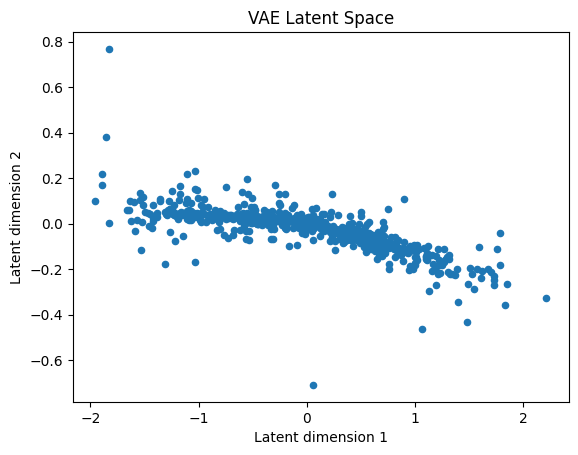

In [31]:
import torch
import torch.nn as nn
import torch.optim as optim

class VAE(nn.Module):
    def __init__(self, input_shape, n_features=2):
        super(VAE, self).__init__()
        
        # Encoder
        self.fc1 = nn.Linear(input_shape, 128)
        self.fc2_mean = nn.Linear(128, n_features)  
        self.fc2_logvar = nn.Linear(128, n_features)  
        
        # Decoder
        self.fc3 = nn.Linear(n_features, 128)
        self.fc4 = nn.Linear(128, input_shape)
        
    def encode(self, x):
        h1 = torch.relu(self.fc1(x))
        mean = self.fc2_mean(h1)
        logvar = self.fc2_logvar(h1)
        return mean, logvar
    
    def reparameterize(self, mean, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mean + eps * std 
    
    def decode(self, z):
        h3 = torch.relu(self.fc3(z))
        return torch.sigmoid(self.fc4(h3))
    
    def forward(self, x):
        mean, logvar = self.encode(x)
        z = self.reparameterize(mean, logvar)
        return self.decode(z), mean, logvar


def vae_loss(recon_x, x, mean, logvar):
    x = torch.nn.functional.sigmoid(x)
    recon_loss = F.mse_loss(recon_x, x, reduction='sum')
    
    # KL Divergence loss
    kl_loss = -0.5 * torch.sum(1 + logvar - mean.pow(2) - logvar.exp())
    print(recon_loss, kl_loss)
    
    return recon_loss + kl_loss

vae = VAE(data_tensor.shape[1])
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)
optimizer = optim.Adam(vae.parameters(), lr=0.001)

num_epochs = 100
training_losses = []
training_loss = 0
for epoch in range(num_epochs):
    for i in range(data_tensor.shape[0]):
        data = data_tensor[i]
        recon_data, mean, logvar = vae(data)
        loss = vae_loss(recon_data, data, mean, logvar)
        training_loss += loss.item()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    scheduler.step()
    

    training_loss /= data_tensor.shape[0]
    training_losses.append(training_loss)
    
    if (epoch+1) % 10 == 0:
        print(f'Epoch {epoch+1}, Loss: {training_loss}')

mean, _ = vae.encode(data_tensor)
mean_np = mean.detach().numpy()
print(mean_np.shape)

plt.scatter(mean_np[:,0], mean_np[:,1], s=20, cmap='viridis')
plt.title('VAE Latent Space')
plt.xlabel('Latent dimension 1')
plt.ylabel('Latent dimension 2')
plt.show()

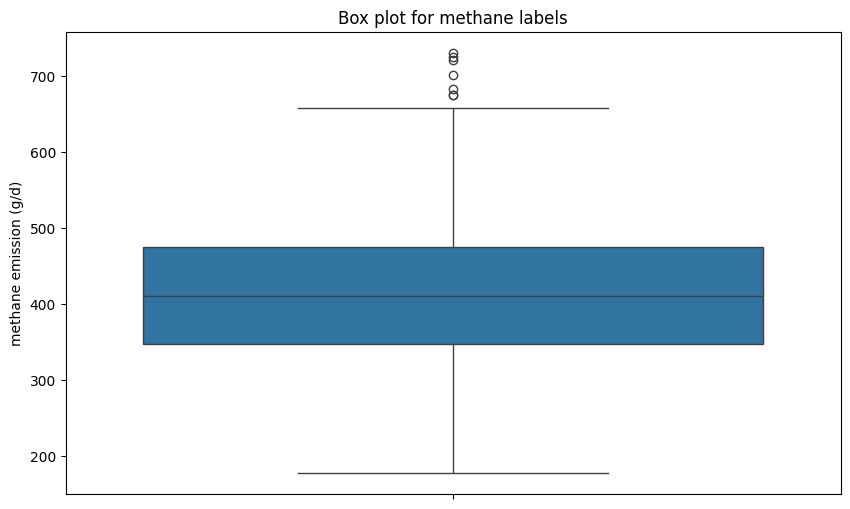

In [87]:
# Box plot for labels
plt.figure(figsize=(10, 6))
sns.boxplot(data=methane_label)
plt.title('Box plot for methane labels')
plt.show()

## Preprocessing steps from paper

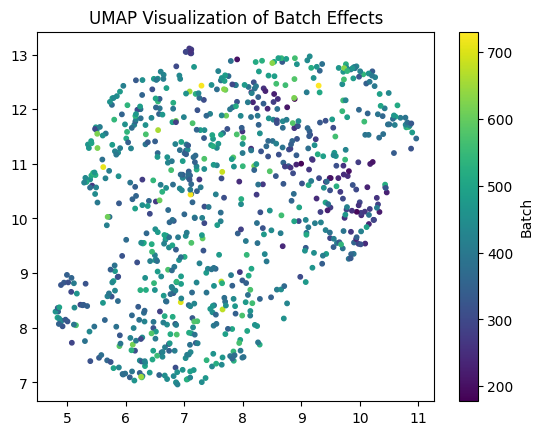

In [86]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(methane_data.iloc[:, 5:-1])

plt.scatter(embedding[:, 0], embedding[:, 1], c=methane_label, cmap='viridis', s=10)
plt.title('UMAP Visualization of Batch Effects')
plt.colorbar(label='Batch')
plt.show()

In [51]:
herd_columns = herd_data.columns
herd_dict = {herd: i for i, herd in enumerate(herd_columns)}
methane_batch = herd_data[herd_columns].idxmax(axis=1)
methane_batch = methane_batch.map(herd_dict)
methane_data['batch'] = methane_batch

In [ ]:
# I don't think we need batch effect correction because i am only using one dataset
methane_label = methane_data['batch'].values 

In [65]:
corrected_data = pycombat(methane_data.iloc[:, 5:].transpose(), methane_data['batch'])

Found 5 batches.
Adjusting for 0 covariate(s) or covariate level(s).
Standardizing Data across genes.
Fitting L/S model and finding priors.
Finding parametric adjustments.
Adjusting the Data


## Feature selection

In [3]:
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import Lasso, Ridge
from sklearn.feature_selection import mutual_info_regression
from sklearn.ensemble import RandomForestRegressor

In [4]:
# F-statistic for each feature ANOVA
f_selector = SelectKBest(f_regression, k='all')
data_f = f_selector.fit_transform(methane_data.iloc[:, :-1], methane_label)

f_scores = f_selector.scores_

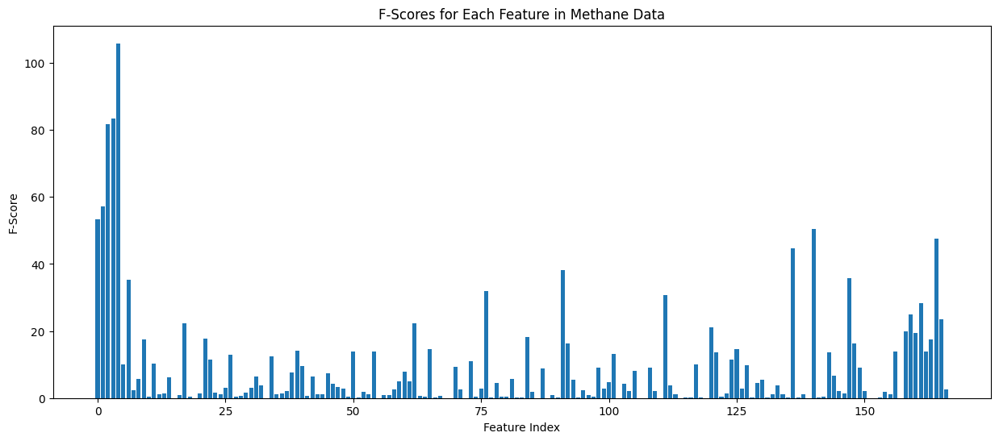

In [5]:
plt.figure(figsize=(15, 6))
plt.bar(range(len(f_scores)), f_scores)
plt.xlabel('Feature Index')
plt.ylabel('F-Score')
plt.title('F-Scores for Each Feature in Methane Data')
plt.show()

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:697: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.177e+06, tolerance: 7.146e+02
  model = cd_fast.enet_coordinate_descent(


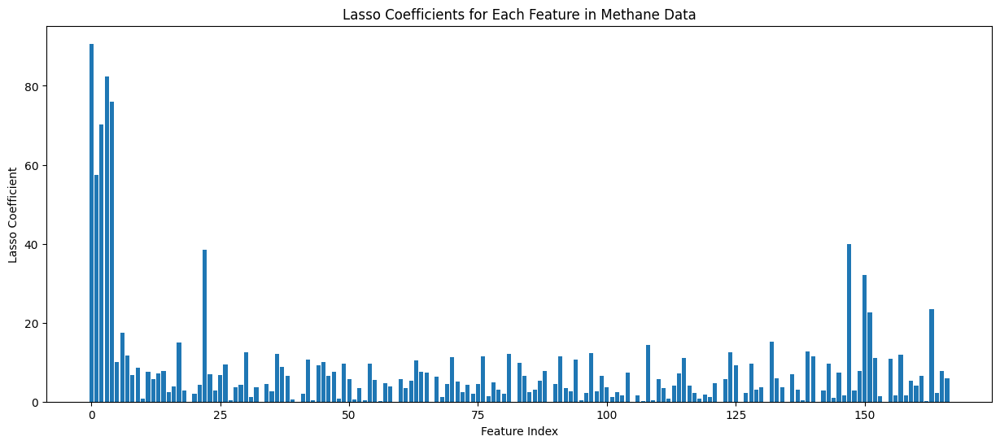

In [6]:
lasso_model = Lasso(alpha=0.1)
lasso_model.fit(methane_data.iloc[:, :-1], methane_label)

lasso_coefs = np.abs(lasso_model.coef_)

plt.figure(figsize=(15, 6))
plt.bar(range(len(lasso_coefs)), lasso_coefs)
plt.xlabel('Feature Index')
plt.ylabel('Lasso Coefficient')
plt.title('Lasso Coefficients for Each Feature in Methane Data')
plt.show()

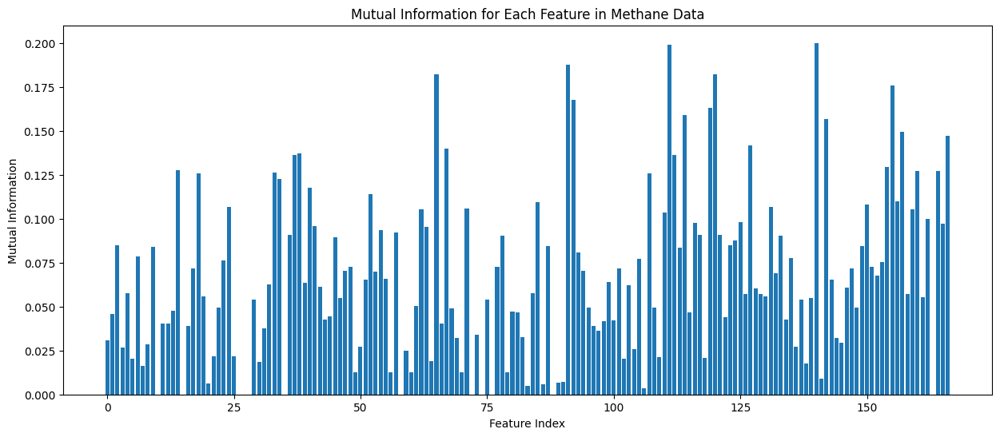

In [7]:
mutual = mutual_info_regression(methane_data.iloc[:, :-1], methane_label)

plt.figure(figsize=(15, 6))
plt.bar(range(len(mutual)), mutual)
plt.xlabel('Feature Index')
plt.ylabel('Mutual Information')
plt.title('Mutual Information for Each Feature in Methane Data')
plt.show()

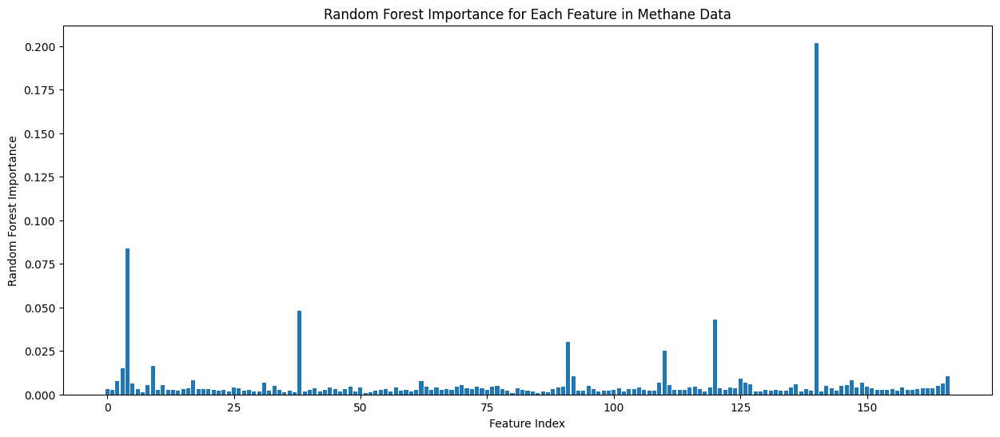

In [8]:
rf_selector = RandomForestRegressor()
rf_selector.fit(methane_data.iloc[:, :-1], methane_label)
rf_importances = rf_selector.feature_importances_

plt.figure(figsize=(15, 6))
plt.bar(range(len(rf_importances)), rf_importances)
plt.xlabel('Feature Index')
plt.ylabel('Random Forest Importance')
plt.title('Random Forest Importance for Each Feature in Methane Data')
plt.show()

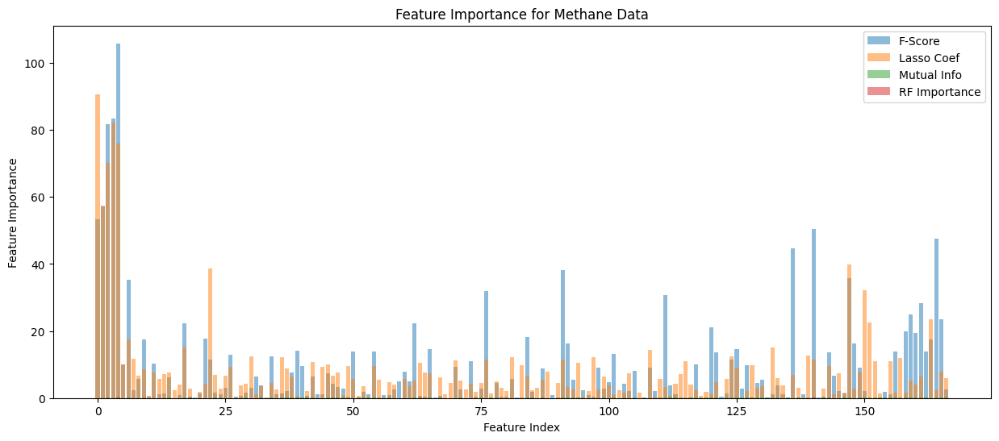

In [9]:
# Combined plot
plt.figure(figsize=(15, 6))
plt.bar(range(len(f_scores)), f_scores, alpha=0.5, label='F-Score')
plt.bar(range(len(lasso_coefs)), lasso_coefs, alpha=0.5, label='Lasso Coef')
plt.bar(range(len(mutual)), mutual, alpha=0.5, label='Mutual Info')
plt.bar(range(len(rf_importances)), rf_importances, alpha=0.5, label='RF Importance')
plt.xlabel('Feature Index') 
plt.ylabel('Feature Importance')
plt.title('Feature Importance for Methane Data')
plt.legend()

In [361]:
high_f_score_indices = [index for index, score in enumerate(f_scores) if score > 20]
high_lasso_indices = [index for index, coef in enumerate(lasso_coefs) if coef > 20]
high_mutual_indices = [index for index, mutual_info in enumerate(mutual) if mutual_info > 0.125]
high_rf_indices = [index for index, importance in enumerate(rf_importances) if importance > 0.025]

merge_indices = list(set(high_f_score_indices) | set(high_lasso_indices) | set(high_mutual_indices) | set(high_rf_indices))
merge_indices.sort()

selected_data = methane_data.iloc[:, merge_indices]
norm_selected_data = z_score_scaler.fit_transform(selected_data)
selected_data = pd.DataFrame(norm_selected_data, columns=selected_data.columns)
selected_data = pd.concat([selected_data, herd_data], axis=1)

In [362]:
selected_data

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ga6a1 group,Bacteria: rikenellaceae rc9 gut group,Bacteria: u29-b03,Bacteria: lachnospiraceae nk3a20 group,Bacteria: anaerosporobacter,Bacteria: marvinbryantia,Bacteria: oribacterium,Bacteria: lachnospiraceae ucg-001,Bacteria: cag-352,Bacteria: uncultured.2,Bacteria: saccharofermentans,Bacteria: anaeroplasma,Bacteria: ned5e9,Bacteria: veillonellaceae ucg-001,Bacteria: succinivibrionaceae ucg-001,Bacteria: succinivibrionaceae ucg-002,Bacteria: ruminobacter,Bacteria: succinimonas,Bacteria: uncultured.8,Bacteria: acetobacter,Bacteria: olsenella,Bacteria: desulfovibrio,Bacteria: cpla-4 termite group,Bacteria: endomicrobium,Archaea: methanosphaera,Archaea: candidatus methanomethylophilus,Archaea: uncultured,Protozoa: ophryoscolex,Protozoa: polyplastron,Protozoa: dasytricha,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Herd IT1,Herd IT2,Herd IT3,Herd UK1,Herd UK2
0,-0.578657,-0.583897,-0.678436,-0.116346,-0.663198,1.611322,-0.535920,0.742384,1.157540,-0.381778,-0.016328,0.074553,-0.574311,-0.572237,7.550762,0.343628,0.228043,2.875658,3.649790,-0.058930,1.081390,0.747946,0.732251,0.298868,0.078270,-0.676898,-0.652941,-0.524736,-0.476454,-0.526605,-0.762981,-0.296425,-0.242562,-0.097133,-0.888495,-0.674928,1.004355,-0.089299,-0.580314,-0.674227,1.114788,-0.692504,-0.585941,0,1,0,0,0
1,1.686585,1.665138,1.289326,2.330341,0.508392,0.530812,0.041821,0.389859,1.470245,0.150404,10.659881,0.837384,-0.549077,-0.499834,4.280697,1.697368,-0.272814,2.806975,0.399051,1.211485,-1.113313,2.161953,2.658180,1.647104,2.399713,-0.711530,-0.928868,-1.071480,-0.483120,1.423492,-0.418049,-0.323236,-0.262792,-0.443561,-0.466398,-0.659171,-0.425699,-0.094653,-0.252064,-0.448318,0.005923,-0.782169,4.901157,0,1,0,0,0
2,-0.335283,-0.342264,-0.467023,0.146522,-0.537324,2.486174,-0.300385,-0.038395,0.489633,-0.595900,-0.152803,-0.867839,-0.565414,-0.603145,0.123583,-0.416988,0.017391,-0.538816,-0.373037,-0.171687,1.172774,-0.595151,-0.223954,-0.508295,-0.293174,-0.720824,-0.851269,-0.097879,-0.508861,-0.021778,-0.076329,-0.252191,-0.160031,-0.190020,0.062600,-0.217403,-0.325228,-0.418703,-0.784230,0.376834,0.443264,-0.574904,-0.303490,0,1,0,0,0
3,0.267349,0.256056,0.056469,0.797425,-0.225641,0.266825,-0.537141,-0.319886,-0.138648,-0.493454,-0.051579,-0.301997,-0.549687,-0.552408,2.352728,-0.069938,0.976172,0.748938,0.824722,-1.033208,0.853359,-0.102772,0.033118,-0.428288,-0.286000,-0.681750,-0.791975,-0.458759,-0.510681,-0.558249,-0.246561,-0.256587,-0.220719,0.403582,-0.888668,-0.678806,1.507146,0.699348,0.933044,-0.542055,0.367676,-0.632421,-0.181759,0,1,0,0,0
4,1.039388,1.022571,0.727121,1.631303,0.173660,0.039828,-0.529334,-0.084169,0.247665,0.355090,-0.166112,0.436976,-0.548624,-0.512898,0.481030,-0.842527,0.046666,1.611108,0.186177,-0.604188,0.737655,-0.169750,0.980907,-0.462447,0.245540,-0.714003,-0.150087,-0.997070,-0.489969,-0.640045,0.087272,-0.304548,-0.263541,-0.100012,-0.888844,-0.679650,1.407883,0.177306,0.348735,-0.376499,1.176317,-0.466679,-0.340084,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,0.356105,0.394241,0.658787,0.162280,0.907140,-0.505829,-0.052499,0.632706,-0.084496,0.792610,-0.029145,0.919825,-0.547123,-0.289634,2.086625,0.552290,-0.035012,0.277361,1.614721,-0.115230,-0.822318,1.613279,0.517366,0.522859,0.258091,0.998819,-0.042649,0.730109,-0.469312,0.739889,-0.079022,0.397896,0.317940,0.094140,3.138087,0.297547,-0.425128,0.285888,-0.684352,-0.903287,0.116186,2.259900,-0.588822,0,0,0,1,0
810,-0.017513,0.019929,0.274580,-0.099364,0.722805,-0.399451,-0.617959,-0.014960,-0.290639,0.116881,-0.224689,0.676005,-0.590343,-0.583051,0.447648,-0.629495,0.404190,-0.138913,0.

In [116]:
selected_data.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ga6a1 group,Bacteria: rikenellaceae rc9 gut group,Bacteria: u29-b03,Bacteria: lachnospiraceae nk3a20 group,...,Protozoa: entodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Herd IT1,Herd IT2,Herd IT3,Herd UK1,Herd UK2
count,8.140000e+02,8.140000e+02,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,814.000000,8.140000e+02,8.140000e+02,814.000000,...,814.000000,8.140000e+02,8.140000e+02,8.140000e+02,814.000000,814.000000,814.000000,814.000000,814.000000,814.000000
mean,6.983221e-16,4.189933e-16,-3.491610e-16,-4.888255e-16,1.047483e-16,0.000000,0.000000,-1.745805e-17,-1.745805e-17,0.000000,...,0.000000,-8.729026e-18,-3.055159e-17,-1.091128e-18,0.000000,0.226044,0.216216,0.058968,0.298526,0.200246
std,1.000615e+00,1.000615e+00,1.000615e+00,1.000615e+00,1.000615e+00,1.000615,1.000615,1.000615e+00,1.000615e+00,1.000615,...,1.000615,1.000615e+00,1.000615e+00,1.000615e+00,1.000615,0.418525,0.411917,0.235710,0.457893,0.400430
min,-2.157622e+00,-2.216208e+00,-2.201813e+00,-2.234973e+00,-1.717801e+00,-2.171927,-1.152618,-2.023847e+00,-1.530161e+00,-1.447665,...,-1.787368,-2.791462e+00,-2.085220e+00,-1.156846e+00,-0.594630,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-7.200049e-01,-7.149884e-01,-7.284209e-01,-7.295169e-01,-7.746991e-01,-0.711795,-0.510461,-7.190221e-01,-5.370250e-01,-0.626191,...,-0.726551,-6.498954e-01,-7.224233e-01,-7.203207e-01,-0.577538,0.000000,0.000000,0.000000,0.000000,0.000000
50%,-3.866354e-02,-4.114347e-02,-6.995804e-02,-7.951770e-02,-2.326278e-01,-0.143403,-0.205121,-1.301139e-01,-2.147772e-01,-0.266936,...,-0.114619,-6.566463e-02,-3.243545e-02,-2.253908e-01,-0.187242,0.000000,0.000000,0.000000,0.000000,0.000000
75%,6.776293e-01,6.601655e-01,6.688650e-01,6.314619e-01,6.686231e-01,0.617484,0.173774,5.883211e-01,2.855416e-01,0.550197,...,0.552384,5.801797e-01,6.473198e-01,5.275938e-01,-0.112169,0.000000,0.000000,0.000000,1.000000,0.000000
max,2.910568e+00,2.915614e+00,3.221836e+00,3.496102e+00,3.038579e+00,4.603333,10.119755,4.547101e+00,7.556555e+00,6.077946,...,4.650513,4.227621e+00,4.371472e+00,5.448588e+00,6.993646,1.000000,1.000000,1.000000,1.000000,1.000000


In [117]:
methane_label.describe()

count    814.000000
mean     411.671723
std       93.755540
min      177.623714
25%      346.243422
50%      409.211757
75%      472.239119
max      730.448718
Name: methane emission (g/d), dtype: float64

In [363]:
z_scores = np.abs(sp.stats.zscore(selected_data))
methane_data_clean = selected_data[(z_scores < 4.5).all(axis=1)]

In [150]:
methane_data_clean

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ga6a1 group,Bacteria: rikenellaceae rc9 gut group,Bacteria: u29-b03,Bacteria: lachnospiraceae nk3a20 group,...,Protozoa: entodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Herd IT1,Herd IT2,Herd IT3,Herd UK1,Herd UK2
2,-0.335283,-0.342264,-0.467023,0.146522,-0.537324,2.486174,-0.300385,-0.038395,0.489633,-0.595900,...,-0.784230,0.376834,0.443264,-0.574904,-0.303490,0,1,0,0,0
3,0.267349,0.256056,0.056469,0.797425,-0.225641,0.266825,-0.537141,-0.319886,-0.138648,-0.493454,...,0.933044,-0.542055,0.367676,-0.632421,-0.181759,0,1,0,0,0
4,1.039388,1.022571,0.727121,1.631303,0.173660,0.039828,-0.529334,-0.084169,0.247665,0.355090,...,0.348735,-0.376499,1.176317,-0.466679,-0.340084,0,1,0,0,0
5,0.227854,0.216843,0.022160,0.754766,-0.246068,1.311443,-0.572898,0.571630,0.311533,-0.867644,...,-0.473034,-0.054571,0.996929,-0.489160,-0.437129,0,1,0,0,0
6,0.203302,0.192467,0.000833,0.728247,-0.258767,-0.010282,-0.205688,-0.428522,-0.057039,-0.456983,...,0.499499,0.485027,-0.325554,-0.597904,3.023778,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,0.356105,0.394241,0.658787,0.162280,0.907140,-0.505829,-0.052499,0.632706,-0.084496,0.792610,...,-0.684352,-0.903287,0.116186,2.259900,-0.588822,0,0,0,1,0
810,-0.017513,0.019929,0.274580,-0.099364,0.722805,-0.399451,-0.617959,-0.014960,-0.290639,0.116881,...,-0.954273,0.253741,0.300698,1.566082,-0.590243,0,0,0,1,0
811,-0.244536,-0.207756,0.080931,-0.416174,0.462930,-0.034445,-0.282223,0.271798,-0.266841,0.833448,...,-1.609905,0.254014,0.950367,0.662680,-0.576165,0,0,0,1,0
812,1.838051,1.879318,2.120096,1.448430,1.870974,-0.148772,-0.546007,-0.018946,-0.357889,0.513915,...,-1.337851,-0.424487,0.615725,0.564586,-0.157480,0,0,0,1,0


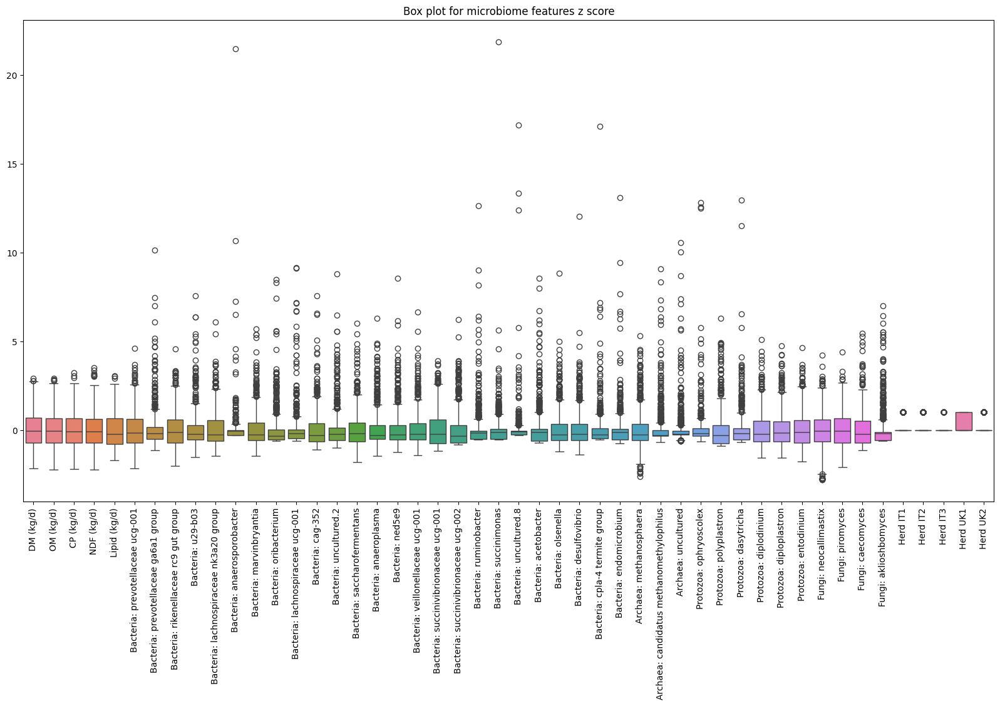

In [145]:
# Box plot for microbiome features z score
plt.figure(figsize=(20, 10))
sns.boxplot(data=selected_data)
plt.title('Box plot for microbiome features z score')
plt.xticks(rotation=90)
plt.show()

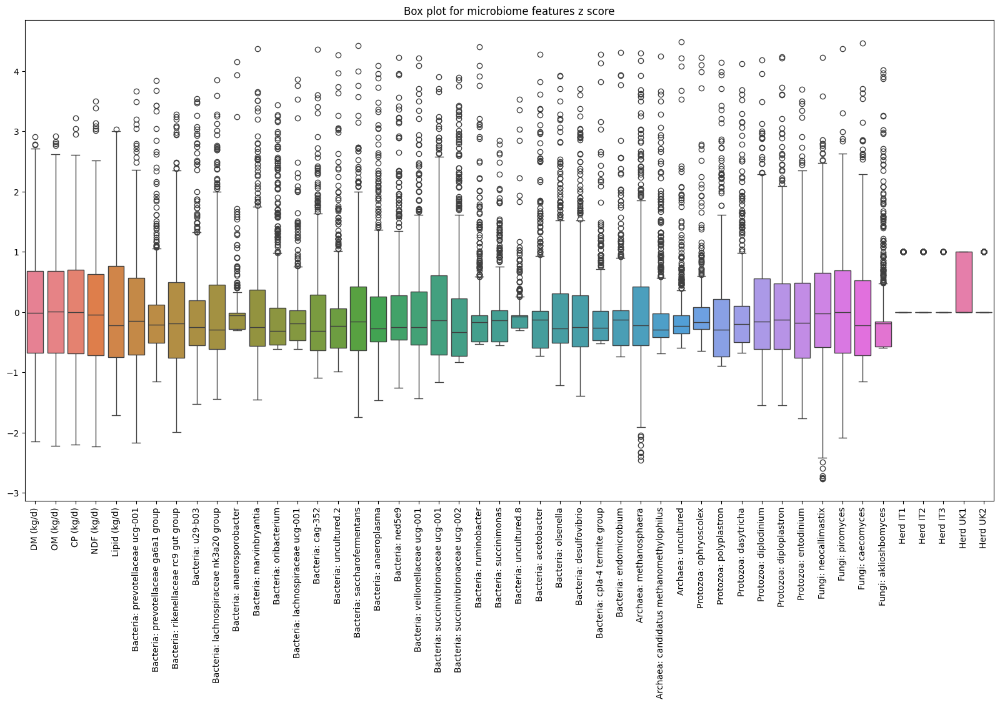

In [151]:
# Box plot for microbiome features z score
plt.figure(figsize=(20, 10))
sns.boxplot(data=methane_data_clean)
plt.title('Box plot for microbiome features z score')
plt.xticks(rotation=90)
plt.show()

In [366]:
selected_data = methane_data_clean
methane_label = methane_label.loc[selected_data.index]

In [227]:
selected_data.columns

Index(['DM (kg/d)', 'OM (kg/d)', 'CP (kg/d)', 'NDF (kg/d)', 'Lipid (kg/d)', 'Bacteria: prevotellaceae ucg-001', 'Bacteria: prevotellaceae ga6a1 group', 'Bacteria: rikenellaceae rc9 gut group', 'Bacteria: u29-b03', 'Bacteria: lachnospiraceae nk3a20 group', 'Bacteria: anaerosporobacter', 'Bacteria: marvinbryantia', 'Bacteria: oribacterium', 'Bacteria: lachnospiraceae ucg-001', 'Bacteria: cag-352', 'Bacteria: uncultured.2', 'Bacteria: saccharofermentans', 'Bacteria: anaeroplasma', 'Bacteria: ned5e9', 'Bacteria: veillonellaceae ucg-001', 'Bacteria: succinivibrionaceae ucg-001', 'Bacteria: succinivibrionaceae ucg-002', 'Bacteria: ruminobacter', 'Bacteria: succinimonas', 'Bacteria: uncultured.8', 'Bacteria: acetobacter', 'Bacteria: olsenella', 'Bacteria: desulfovibrio', 'Bacteria: cpla-4 termite group', 'Bacteria: endomicrobium', 'Archaea: methanosphaera', 'Archaea: candidatus methanomethylophilus', 'Archaea: uncultured', 'Protozoa: ophryoscolex', 'Protozoa: polyplastron',
       'Protozoa: 

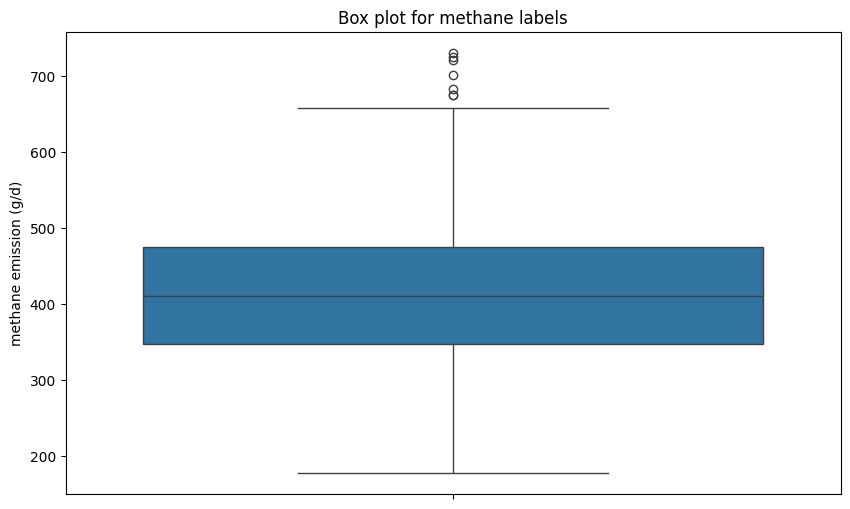

In [367]:
# Box plot for labels
plt.figure(figsize=(10, 6))
sns.boxplot(data=methane_label)
plt.title('Box plot for methane labels')
plt.show()

In [349]:
indices_to_remove = methane_label[methane_label > 550].index

methane_label = methane_label.drop(indices_to_remove)
selected_data = selected_data.drop(indices_to_remove)

print(methane_label.describe())
print(selected_data.describe())

count    625.000000
mean     397.423645
std       80.134699
min      177.623714
25%      344.427451
50%      403.373044
75%      457.763158
max      547.555606
Name: methane emission (g/d), dtype: float64
        DM (kg/d)   OM (kg/d)   CP (kg/d)  NDF (kg/d)  Lipid (kg/d)  Bacteria: prevotellaceae ucg-001  Bacteria: prevotellaceae ga6a1 group  Bacteria: rikenellaceae rc9 gut group  Bacteria: u29-b03  Bacteria: lachnospiraceae nk3a20 group  Bacteria: anaerosporobacter  Bacteria: marvinbryantia  Bacteria: oribacterium  Bacteria: lachnospiraceae ucg-001  Bacteria: cag-352  Bacteria: uncultured.2  Bacteria: saccharofermentans  Bacteria: anaeroplasma  Bacteria: ned5e9  Bacteria: veillonellaceae ucg-001  Bacteria: succinivibrionaceae ucg-001  Bacteria: succinivibrionaceae ucg-002  Bacteria: ruminobacter  Bacteria: succinimonas  Bacteria: uncultured.8  Bacteria: acetobacter  Bacteria: olsenella  Bacteria: desulfovibrio  Bacteria: cpla-4 termite group  Bacteria: endomicrobium  Archaea: methano

(679, 49)
0    582.061333
1    545.326087
2    582.260317
3    683.234551
4    658.535088
Name: methane emission (g/d), dtype: float64


r_index: 100%|##########| 49/49 [00:00<00:00, 947.32it/s]


count    1092.000000
mean      409.986277
std       131.132056
min       177.623714
25%       286.450507
50%       405.865775
75%       528.065440
max       730.448718
Name: methane emission (g/d), dtype: float64


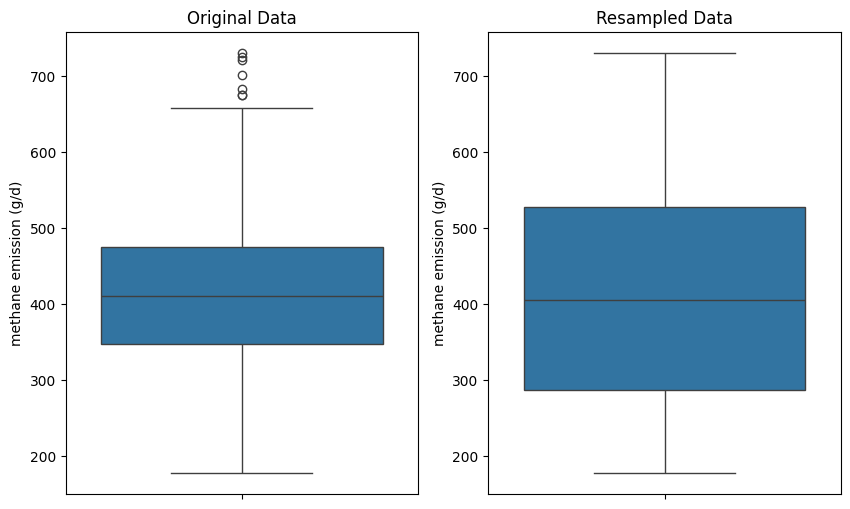

In [411]:
import smogn

data = pd.concat([selected_data, methane_label], axis=1)
data.reset_index(drop=True, inplace=True)
print(data.shape)
print(data["methane emission (g/d)"].head())

data_resampled = smogn.smoter(
    data,  
    y="methane emission (g/d)", 
    k=20,  
    samp_method="extreme", 
    rel_thres=0.5,  
    pert=0.02,  
    rel_coef=1.3
)

selected_data_resampled = data_resampled.drop(columns=["methane emission (g/d)"])
methane_label_resampled = data_resampled["methane emission (g/d)"]
print(methane_label_resampled.describe())

fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.boxplot(data=methane_label, ax=ax[0])
ax[0].set_title('Original Data')
sns.boxplot(data=methane_label_resampled, ax=ax[1])
ax[1].set_title('Resampled Data')
plt.show()

In [412]:
selected_data_resampled.describe()

,DM (kg/d),OM (kg/d),CP (kg/d),NDF (kg/d),Lipid (kg/d),Bacteria: prevotellaceae ucg-001,Bacteria: prevotellaceae ga6a1 group,Bacteria: rikenellaceae rc9 gut group,Bacteria: u29-b03,Bacteria: lachnospiraceae nk3a20 group,Bacteria: anaerosporobacter,Bacteria: marvinbryantia,Bacteria: oribacterium,Bacteria: lachnospiraceae ucg-001,Bacteria: cag-352,Bacteria: uncultured.2,Bacteria: saccharofermentans,Bacteria: anaeroplasma,Bacteria: ned5e9,Bacteria: veillonellaceae ucg-001,Bacteria: succinivibrionaceae ucg-001,Bacteria: succinivibrionaceae ucg-002,Bacteria: ruminobacter,Bacteria: succinimonas,Bacteria: uncultured.8,Bacteria: acetobacter,Bacteria: olsenella,Bacteria: desulfovibrio,Bacteria: cpla-4 termite group,Bacteria: endomicrobium,Archaea: methanosphaera,Archaea: candidatus methanomethylophilus,Archaea: uncultured,Protozoa: ophryoscolex,Protozoa: polyplastron,Protozoa: dasytricha,Protozoa: diplodinium,Protozoa: diploplastron,Protozoa: entodinium,Fungi: neocallimastix,Fungi: piromyces,Fungi: caecomyces,Fungi: aklioshbomyces,Herd IT1,Herd IT2,Herd IT3,Herd UK1,Herd UK2
count,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000,1092.000000
mean,0.157959,0.159953,0.142489,0.149954,0.140569,0.082050,-0.027818,0.032958,-0.002424,0.044002,-0.017891,0.047145,0.109936,-0.017015,0.019712,-0.032396,0.091776,0.069598,0.061615,0.038007,0.256545,0.106784,0.000947,-0.004396,-0.031364,-0.031084,0.060640,0.155926,0.024805,-0.001071,0.283195,0.003878,-0.042541,0.003952,0.006013,0.035836,0.126477,0.109859,0.110601,0.253764,0.109139,0.117929,0.013370,0.329670,0.173993,0.034799,0.225275,0.094322
std,0.825483,0.826881,0.827527,0.845249,0.835896,0.789223,0.541985,0.769921,0.648866,0.738149,0.308189,0.734189,0.701904,0.451589,0.684037,0.606778,0.780411,0.725848,0.696911,0.754328,0.883835,0.847342,0.542903,0.448779,0.281893,0.561908,0.723066,0.824141,0.553206,0.561143,0.987018,0.576260,0.433717,0.457530,0.687560,0.617428,0.798402,0.786330,0.806699,0.867208,0.804047,0.807133,0.669073,0.470309,0.379277,0.183353,0.417955,0.292411
min,-2.152697,-2.216208,-2.201813,-2.187704,-1.644349,-2.171927,-1.152618,-1.942872,-1.530161,-1.447665,-0.306263,-1.449538,-0.617320,-0.616207,-1.088929,-0.985772,-1.685455,-1.461717,-1.257562,-1.416558,-1.160335,-0.828693,-0.529663,-0.549250,-0.297965,-0.725769,-1.211299,-1.392313,-0.523075,-0.738636,-2.457089,-0.687933,-0.597707,-0.645940,-0.890324,-0.680464,-1.548177,-1.546195,-1.759974,-2.768917,-2.085220,-1.156846,-0.594593,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-0.142209,-0.154735,-0.212199,-0.197398,-0.345497,-0.310440,-0.273354,-0.322040,-0.346852,-0.420407,-0.143483,-0.353490,-0.328510,-0.217603,-0.370184,-0.275569,-0.338288,-0.345156,-0.289260,-0.363617,-0.295115,-0.332648,-0.185253,-0.138305,-0.165191,-0.156439,-0.373976,-0.364340,-0.288108,-0.147917,-0.324239,-0.304115,-0.235976,-0.197445,-0.305092,-0.200189,-0.264716,-0.215486,-0.317869,-0.165723,-0.149654,-0.370612,-0.290418,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.124764,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.095785,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.579918,0.575763,0.552812,0.592152,0.535902,0.413771,

In [202]:
methane_label = methane_label / 10
print(methane_label.describe())

count    679.000000
mean     413.590889
std       95.493938
min      177.623714
25%      347.923021
50%      411.164254
75%      474.780864
max      730.448718
Name: methane emission (g/d), dtype: float64


# Models

In [413]:
# X_train, X_test, y_train, y_test = train_test_split(selected_data, methane_label, test_size=0.2, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(selected_data_resampled, methane_label_resampled, test_size=0.2, random_state=42)

## Elastic Net

In [444]:
from sklearn.linear_model import ElasticNet

elastic_net = ElasticNet(alpha=0.1, l1_ratio=1)
elastic_net.fit(X_train, y_train)

ElasticNet(alpha=0.1, l1_ratio=1)

In [445]:
y_pred = elastic_net.predict(X_test)
print('Decision Tree Regressor')
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred)}')
print(f'Mean Absolute Error: {mean_absolute_error(y_test, y_pred)}')
print(f'R^2 Score: {r2_score(y_test, y_pred)}')
print(y_pred - y_test.to_numpy())

Decision Tree Regressor
Mean Squared Error: 4806.9391457345355
Mean Absolute Error: 54.394575415144715
R^2 Score: 0.6904376342823819
[ 113.50125661  -38.84391593  -85.75845181   91.01079075   -5.17766408
    5.57166125  -49.57414631  -34.19956953   82.89160816  -50.65568673
   27.39882575   43.79654424   13.50317107   26.90759068  116.9873341
   45.59462275   90.36805202   22.3849083     4.69541066    5.34822012
  -16.05597619 -103.09997126 -208.68451897  -37.64619362  -46.60914383
   54.81298862  -85.59826635   99.30237362  -91.8254945   -76.62605529
    6.10325098  -90.81738967  -71.49144831  -73.936996    -91.42592975
    7.84328507   71.46513682  -13.7491796     9.52647669    8.31929551
  -33.6255698    16.1594764    13.66594758   84.16631542   17.43409329
  -36.53893307   53.43401342   17.19597778  -45.34958575 -110.99593204
   60.18445874  -48.62358416 -103.81912102   59.84199959  112.47760655
 -126.22711564  -73.32958474  -53.89432875   21.53314376  161.99382561
   -8.30249625  

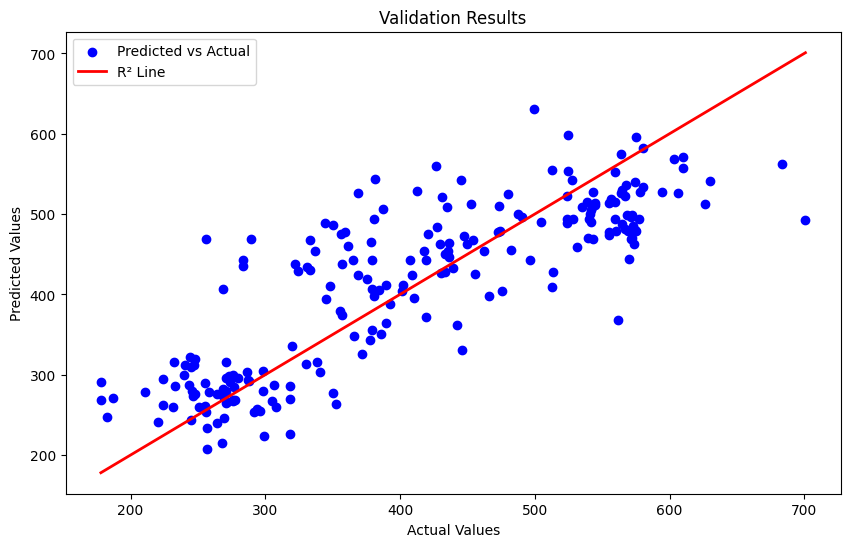

In [446]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()
plt.show()

In [447]:
joblib.dump(elastic_net, 'elastic_net_model.pkl')

['elastic_net_model.pkl']

In [24]:
from sklearn.model_selection import GridSearchCV
# Initialize ElasticNet model
elastic_net = ElasticNet()

# Define the parameter grid
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization strength
    'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9, 1]  # Balance between L1 and L2 regularization
}

# Set up the GridSearchCV
grid_search = GridSearchCV(
    estimator=elastic_net,
    param_grid=param_grid,
    scoring='r2',  # You can also use 'neg_mean_squared_error', 'neg_mean_absolute_error', etc.
    cv=5,  # 5-fold cross-validation
    verbose=1
)

# Perform the grid search
grid_search.fit(X_train, y_train)

# Print the best parameters and best R2 score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best R2 score: {grid_search.best_score_}")

# Evaluate on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Calculate R2 score on the test set
r2 = r2_score(y_test, y_pred)
print(f"Test R2 score: {r2}")

Fitting 5 folds for each of 36 candidates, totalling 180 fits


/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:697: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.247e+05, tolerance: 3.795e+02
  model = cd_fast.enet_coordinate_descent(
/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:697: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.013e+05, tolerance: 3.994e+02
  model = cd_fast.enet_coordinate_descent(
/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:697: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the featu

Best parameters: {'alpha': 0.001, 'l1_ratio': 1}
Best R2 score: 0.54991614477387
Test R2 score: 0.5837521320762086


## Trees and Random Forests

In [167]:
decision_tree = DecisionTreeRegressor(random_state=42)
decision_tree.fit(X_train, y_train)

DecisionTreeRegressor(random_state=42)

In [168]:
y_pred = decision_tree.predict(X_test)
print('Decision Tree Regressor')
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred)}')
print(f'Mean Absolute Error: {mean_absolute_error(y_test, y_pred)}')
print(f'R^2 Score: {r2_score(y_test, y_pred)}')
print(y_pred - y_test.to_numpy())

Decision Tree Regressor
Mean Squared Error: 9838.21069713325
Mean Absolute Error: 72.49358182324636
R^2 Score: -0.16444424084369502
[ 123.71832253   21.35411255   88.92614379    6.10402517    2.66583333
  -57.91622575  -41.75964912   16.23492063  215.05406119 -239.01081783
  -36.11690821 -110.89044459 -150.29430613  -22.55593692   -6.48680556
   64.8805399   163.34382232   92.51078431  179.40705128  -42.5834696
   30.23045419  -30.85290404   -0.99633889   53.60088454  -31.30941426
   82.43958333  -61.68512855   72.044216    -38.40524884  -54.58062096
   41.7385061  -330.78528922   36.62769561  139.60169666  -35.79303856
   58.22720079 -117.65252653   -7.04814815   97.09107604    3.09655504
  -33.55565022   96.61855684   27.41851852   -5.11008251   22.57951389
   10.1354369    12.16018519  -83.91953847   41.56960784  181.14080901
  150.89138299   75.15109259   96.57789812  -30.27081481  215.03496458
   11.25341233  -25.30227273  -66.38060897   97.91928939 -113.48875056
  -32.97935705  -

In [159]:
random_forest = RandomForestRegressor(random_state=42)
random_forest.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [160]:
y_pred = decision_tree.predict(X_test)
print('Decision Tree Regressor')
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred)}')
print(f'Mean Absolute Error: {mean_absolute_error(y_test, y_pred)}')
print(f'R^2 Score: {r2_score(y_test, y_pred)}')
print(y_pred - y_test.to_numpy())

Decision Tree Regressor
Mean Squared Error: 9838.21069713325
Mean Absolute Error: 72.49358182324636
R^2 Score: -0.16444424084369502
[ 123.71832253   21.35411255   88.92614379    6.10402517    2.66583333
  -57.91622575  -41.75964912   16.23492063  215.05406119 -239.01081783
  -36.11690821 -110.89044459 -150.29430613  -22.55593692   -6.48680556
   64.8805399   163.34382232   92.51078431  179.40705128  -42.5834696
   30.23045419  -30.85290404   -0.99633889   53.60088454  -31.30941426
   82.43958333  -61.68512855   72.044216    -38.40524884  -54.58062096
   41.7385061  -330.78528922   36.62769561  139.60169666  -35.79303856
   58.22720079 -117.65252653   -7.04814815   97.09107604    3.09655504
  -33.55565022   96.61855684   27.41851852   -5.11008251   22.57951389
   10.1354369    12.16018519  -83.91953847   41.56960784  181.14080901
  150.89138299   75.15109259   96.57789812  -30.27081481  215.03496458
   11.25341233  -25.30227273  -66.38060897   97.91928939 -113.48875056
  -32.97935705  -

## Support Vector Machine

In [25]:
from sklearn.svm import LinearSVR
linear_svr = LinearSVR(random_state=42)
linear_svr.fit(X_train, y_train)

LinearSVR(random_state=42)

In [26]:
y_pred = linear_svr.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('Support Vector Regression')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

Support Vector Regression
Mean Squared Error: 7921.159825700068
Mean Absolute Error: 69.20903588171348
R^2 Score: 0.13995692804300186
[ -74.03051148  -59.31819135   45.09116703   -6.04365045  -68.124591
 -119.80210849    7.00474117  -55.27376702   32.65075023 -321.3943945
 -112.40263725 -190.45725503 -135.58175317  -13.48464474  -34.33053971
   -4.84332297   -2.50665381   49.74914342   27.57748495  -91.76543478
  -18.95169765  -95.85281068  -49.92551726  -31.39806976  -77.1244277
   -0.65317151 -162.42041485  -21.24467869  -60.62727132  -39.19496319
  -29.31226443 -254.31935467  -26.647222    -20.27487355  -39.53946155
  -91.2134773  -153.51307234  -64.3024511   -32.26849536   34.18273324
  -41.88821284   30.98788572  -28.65723644  -16.6017474   -44.37596064
 -113.53787626  -99.97415414  -58.84707424   40.39865581   48.03441207
   33.56594176  -43.40384927  -11.24117114   -9.97703497   -6.45721897
  -26.51219465  -99.29616915 -131.73612122   67.11506958 -138.28621942
  -36.63251962 -10

In [448]:
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=0.1)
svr_model.fit(X_train, y_train)

SVR(C=100, gamma=0.1)

In [449]:
y_pred = svr_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('Support Vector Regression')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

Support Vector Regression
Mean Squared Error: 3103.4945102302427
Mean Absolute Error: 42.57414992119728
R^2 Score: 0.8001378687244212
[ 113.5093547    13.01094511   -1.65053301   27.62979215  -29.26295985
   42.14557263   58.89763978    6.83008351   21.40027313 -113.02744049
   -4.41996514   67.01483574   28.57437998   27.25271296   44.6294419
   33.55638652   25.68867748   31.31404464    9.66358045  -10.71630941
   -6.48779119  -43.2762109   -48.75079138   -9.730654     -5.05548682
   77.93032136  -57.03829514  103.22616232  -87.19231015    9.84816427
   31.45990741  -70.56684471  -44.53681586    2.41619793    9.31711915
  -19.93326178   56.28836613  -43.99101613   56.30535619   16.98731307
  -48.13060833  -14.07643196   11.00770309   50.37416773   56.55271394
    4.3997247    29.83357527    6.63908343   60.62321223  -73.50044127
   90.95528341  -59.09904722  -64.05747635   17.0188558    80.34609518
 -120.72346604   -6.00068149  -76.9395588   -65.5684783    59.5572785
  118.6926514   

In [231]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR

param_grid = {
    'C': [1, 10, 100, 500],
    'epsilon': [0.01, 0.1, 1],
    'kernel': ['rbf', 'linear', 'poly'],  
    'gamma': ['scale', 0.01, 0.1, 0.5]
}

svr = SVR()
grid_search = GridSearchCV(svr, param_grid, cv=5, scoring='r2')
grid_search.fit(X_train, y_train)

print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score:", grid_search.best_score_)

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Best parameters: {'C': 500, 'epsilon': 1, 'gamma': 'scale', 'kernel': 'linear'}
Best cross-validation score: 0.5353245098222625


In [232]:
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('Support Vector Regression')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

Support Vector Regression
Mean Squared Error: 3687.0662849712185
Mean Absolute Error: 45.51426347094679
R^2 Score: 0.5996753147250795
[ -16.15768036   14.93083691   51.39779979   21.68374538  -10.40757941
  -21.00213918    3.73946938  -82.42970836   81.5749851  -228.27563228
  -37.81763825 -116.77138448  -75.38450697   15.6086165   -15.94658732
   65.57139495   25.58962955   48.23972482   10.48991716  -38.9360788
    5.3631635   -14.38479027   74.63260951   21.67963869  -29.25742476
    5.81818611  -61.00752642   -6.59987174  -46.14856145   -2.37852004
   -5.94048014 -242.74762261   36.88478483   57.72094725   41.43323398
  -25.2198739   -32.60531083  -39.87702852   36.99238077   62.77303255
   15.72372525   82.43566652   10.47434606   96.24197131  -25.48741025
  -25.29331366  -49.56127265   -5.52926197   42.79605681   69.53316945
  114.39753124    7.1631033    28.30926309   35.09263079   45.84835854
   -7.80650713   -6.5319879  -136.02945402   77.51175052  -56.53872596
   15.38748765 

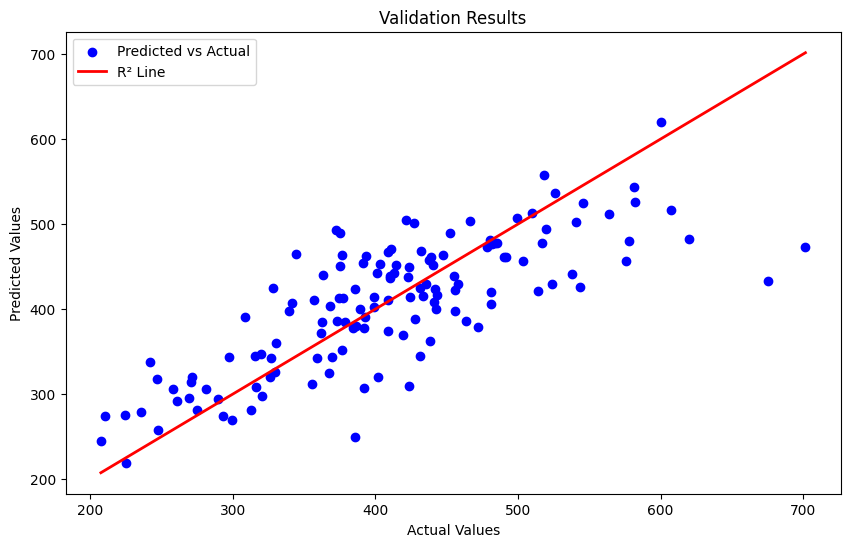

In [233]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()
plt.show()

In [450]:
joblib.dump(best_model, 'svr_model.pkl')

['svr_model.pkl']

In [223]:
from sklearn.model_selection import cross_val_score

best_model = grid_search.best_estimator_
scores = cross_val_score(best_model, X_train, y_train, cv=5, scoring='r2')
print("Cross-validated R² scores:", scores)

Cross-validated R² scores: [0.65627234 0.61943033 0.51061335 0.44723335 0.59987775]


## KNN Regression

In [454]:
from sklearn.neighbors import KNeighborsRegressor
knn_model = KNeighborsRegressor(n_neighbors=3)
knn_model.fit(X_train, y_train)

KNeighborsRegressor(n_neighbors=3)

In [455]:
y_pred_knn = knn_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred_knn)
mae = mean_absolute_error(y_test, y_pred_knn)
r2 = r2_score(y_test, y_pred_knn)
print('K Nearest Neighbors')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(np.array(y_pred_knn) - y_test.to_numpy())

K Nearest Neighbors
Mean Squared Error: 4167.688976165469
Mean Absolute Error: 44.10419577509478
R^2 Score: 0.7316047447403509
[ 1.63219726e+02  1.59478544e+01 -1.00558940e+00  3.27720341e+01
 -1.19540499e+02  4.00054888e+01 -5.28379625e-01 -8.85583086e+01
  2.68954949e+01 -7.77896691e+01 -1.41124995e+00  1.84729627e+02
  8.09755993e+01  1.10432352e+02  2.22040893e+01  3.04806837e+00
 -1.26608496e+01  2.73129777e+01  9.63413604e+01 -2.08977340e+01
  4.33364971e+01  3.89928651e+00 -3.89168205e+00  1.96337204e+01
 -1.97020939e+01  2.61758659e+01 -5.60446166e+01  9.59498887e+01
 -9.69431428e+01 -2.00062563e+00  7.09693133e+01  8.59659676e-01
 -2.85940088e+01 -7.56299565e+00 -3.84937960e+01 -3.22161652e+01
  1.09919000e+02  1.88688143e+01  1.10617631e+02 -2.29737098e+01
 -1.03405165e+02 -9.25515936e+00  6.22660283e+00  5.60881295e+01
  2.02005487e+00  2.16586841e-01  1.18409599e+01  1.96110789e+01
  8.78357094e+01 -6.59575734e+01  1.18764685e+02 -6.17301489e+01
 -7.36651796e+01  2.31197904

In [453]:
from sklearn.model_selection import GridSearchCV

param_grid = {'n_neighbors': list(range(1, 30))}
grid_search = GridSearchCV(KNeighborsRegressor(), param_grid, cv=5)
grid_search.fit(X_train, y_train)

print(f'Best k value: {grid_search.best_params_}')

Best k value: {'n_neighbors': 3}


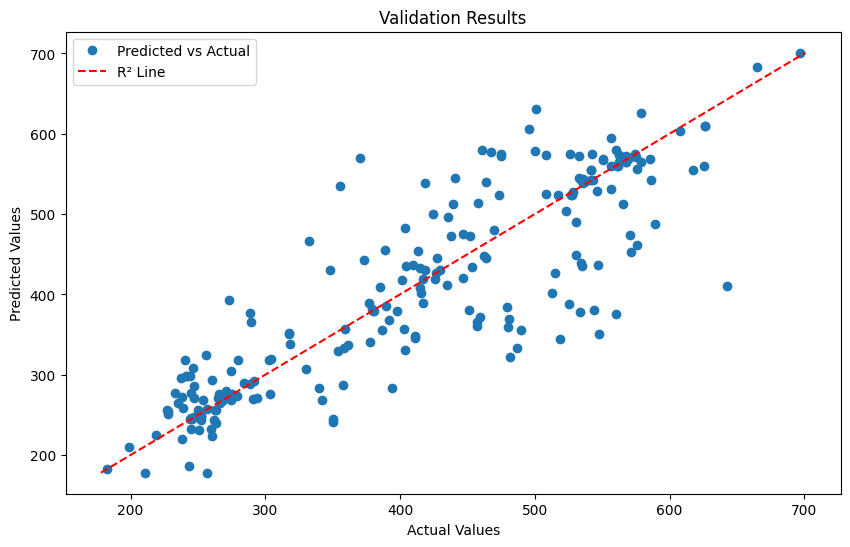

In [456]:
plt.figure(figsize=(10, 6))
plt.plot(y_pred_knn, y_test, 'o', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()
plt.show() 

In [457]:
joblib.dump(knn_model, 'knn_model.pkl')

['knn_model.pkl']

## MLP

In [423]:
class MethaneDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        data = self.data[idx]
        label = self.labels[idx]

        data = torch.tensor(data, dtype=torch.float32)
        label = torch.tensor(label, dtype=torch.float32)

        return data, label
    
class MethaneModel(nn.Module):
    def __init__(self, input_size):
        super().__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.batch_norm1 = nn.BatchNorm1d(64)

        self.fc2 = nn.Linear(64, 32)
        self.batch_norm2 = nn.BatchNorm1d(32)

        self.fc3 = nn.Linear(32, 16)
        self.batch_norm3 = nn.BatchNorm1d(16)

        self.output = nn.Sequential(
            nn.Linear(16, 1),
            nn.Softplus()
        )

        self.dropout = nn.Dropout(0.5)
        
    def forward(self, x):
        x = F.relu(self.batch_norm1(self.fc1(x)))
        x = self.dropout(x)
        x = F.relu(self.batch_norm2(self.fc2(x)))
        x = self.dropout(x)
        x = F.relu(self.batch_norm3(self.fc3(x)))
        x = self.output(x)
        return x
 

class MethaneDenseModel(nn.Module):
    def __init__(self, input_size):
        super().__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.batch_norm1 = nn.BatchNorm1d(128)

        self.fc2 = nn.Linear(128 + input_size, 64)
        self.batch_norm2 = nn.BatchNorm1d(64)

        self.fc3 = nn.Linear(128 + input_size + 64, 16)
        self.batch_norm3 = nn.BatchNorm1d(16)

        self.output = nn.Sequential(
            nn.Linear(16, 1),
            nn.Softplus()
        )

        self.dropout = nn.Dropout(0.5)
        
    def forward(self, x):
        x1 = F.relu(self.batch_norm1(self.fc1(x)))
        x1 = self.dropout(x1)

        x2_input = torch.cat((x, x1), dim=1)
        x2 = F.relu(self.batch_norm2(self.fc2(x2_input)))
        x2 = self.dropout(x2)

        x3_input = torch.cat((x2, x2_input), dim=1)
        x3 = F.relu(self.batch_norm3(self.fc3(x3_input)))
        
        x3 = self.output(x3)
        return x3
    

class MethaneResNet(nn.Module):
    def __init__(self, input_size):
        super().__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.batch_norm1 = nn.BatchNorm1d(128)

        self.fc2 = nn.Linear(128, 64)
        self.batch_norm2 = nn.BatchNorm1d(64)

        self.fc3 = nn.Linear(64, 16)
        self.batch_norm3 = nn.BatchNorm1d(16)

        self.output = nn.Sequential(
            nn.Linear(16, 1),
            nn.Softplus()
        )

        self.dropout = nn.Dropout(0.5)

        self.skip1 = nn.Sequential(
            nn.Linear(input_size, 16),
            nn.ReLU()
        )
    
    def forward(self, x):
        skip = self.skip1(x)

        x = F.relu(self.batch_norm1(self.fc1(x)))
        x = self.dropout(x)
        x = F.relu(self.batch_norm2(self.fc2(x)))
        x = self.dropout(x)
        x = F.relu(self.batch_norm3(self.fc3(x)))
        x = self.output(x + skip)

        return x
    
class WeightedMSELoss(nn.Module):
    def __init__(self, lower_range_weight=1.5, higher_range_weight=1.5):
        super(WeightedMSELoss, self).__init__()
        self.lower_range_weight = lower_range_weight
        self.higher_range_weight = higher_range_weight

    def forward(self, predictions, targets):
        lower_range_mask = targets < 300
        higher_range_mask = targets > 600
        normal_mask = (~lower_range_mask) & (~higher_range_mask)

        loss = nn.MSELoss(reduction='none')(predictions, targets)
        weighted_loss = (
            self.lower_range_weight * lower_range_mask.float() * loss +
            self.higher_range_weight * higher_range_mask.float() * loss +
            loss * normal_mask.float()
        )
        return weighted_loss.mean()

In [424]:
EPOCHS = 400
LEARNING_RATE = 0.001
BATCH_SIZE = 32

train_dataset = MethaneDataset(X_train.to_numpy(), y_train.to_numpy())
test_dataset = MethaneDataset(X_test.to_numpy(), y_test.to_numpy())

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [429]:
model = None

In [430]:
model = MethaneModel(X_train.shape[1])
criterion = nn.MSELoss()
# criterion = WeightedMSELoss(lower_range_weight=2.0, higher_range_weight=2.0)
# optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
optimizer = torch.optim.SGD(model.parameters(), lr=LEARNING_RATE, momentum=0.9)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)

In [431]:
from tqdm import tqdm

training_losses = []
test_losses = []

for epoch in tqdm(range(EPOCHS)):
    training_loss = 0
    test_loss = 0

    model.train()
    for batch, (X, y) in enumerate(train_loader):
        output = model(X)
        loss = criterion(output, y.unsqueeze(1))
        training_loss += loss.item()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    scheduler.step()

    model.eval()
    for X, y in test_loader:
        with torch.no_grad():
            y_pred = model(X)
            test_loss = criterion(y_pred, y.unsqueeze(1))
            test_loss += test_loss.item()

    training_loss /= len(train_loader)
    test_loss /= len(test_loader)

    training_losses.append(training_loss)
    test_losses.append(test_loss)

    if epoch % 10 == 0:
        print(f'Epoch {epoch}, Training Loss: {training_loss} | Test Loss: {test_loss}')

  2%|▏         | 9/400 [00:00<00:08, 44.90it/s]

Epoch 0, Training Loss: 67003.44880022321 | Test Loss: 10058.9716796875
Epoch 10, Training Loss: 7591.199148995535 | Test Loss: 1214.7259521484375


  8%|▊         | 33/400 [00:00<00:05, 69.68it/s]

Epoch 20, Training Loss: 8345.393179757255 | Test Loss: 1536.3167724609375
Epoch 30, Training Loss: 7952.457127162388 | Test Loss: 1212.2899169921875


 12%|█▏        | 48/400 [00:00<00:05, 67.21it/s]

Epoch 40, Training Loss: 7793.287004743303 | Test Loss: 1142.592529296875
Epoch 50, Training Loss: 5680.96146937779 | Test Loss: 843.5596313476562


 18%|█▊        | 72/400 [00:01<00:04, 73.44it/s]

Epoch 60, Training Loss: 6904.673976353237 | Test Loss: 1641.4444580078125
Epoch 70, Training Loss: 4788.120832170759 | Test Loss: 758.0640869140625


 22%|██▏       | 89/400 [00:01<00:04, 75.59it/s]

Epoch 80, Training Loss: 4921.823935372488 | Test Loss: 1132.695068359375
Epoch 90, Training Loss: 9990.316615513393 | Test Loss: 925.3125610351562


 28%|██▊       | 114/400 [00:01<00:03, 78.73it/s]

Epoch 100, Training Loss: 4715.97785295759 | Test Loss: 770.9598388671875
Epoch 110, Training Loss: 4013.0488717215403 | Test Loss: 671.4559936523438


 33%|███▎      | 132/400 [00:01<00:03, 80.04it/s]

Epoch 120, Training Loss: 3847.5840890066966 | Test Loss: 650.7221069335938
Epoch 130, Training Loss: 4687.5101318359375 | Test Loss: 978.9374389648438


 38%|███▊      | 150/400 [00:02<00:03, 70.33it/s]

Epoch 140, Training Loss: 4117.987779889788 | Test Loss: 692.1278686523438


 40%|███▉      | 158/400 [00:02<00:03, 60.93it/s]

Epoch 150, Training Loss: 3855.350655691964 | Test Loss: 698.1721801757812
Epoch 160, Training Loss: 3944.718994140625 | Test Loss: 773.1990356445312


 45%|████▍     | 179/400 [00:02<00:03, 63.48it/s]

Epoch 170, Training Loss: 4112.1701093401225 | Test Loss: 761.7796020507812
Epoch 180, Training Loss: 4119.358577183315 | Test Loss: 795.5143432617188


 50%|█████     | 200/400 [00:02<00:03, 63.04it/s]

Epoch 190, Training Loss: 3793.642320905413 | Test Loss: 774.1864624023438
Epoch 200, Training Loss: 4297.735421316965 | Test Loss: 619.302734375


 56%|█████▌    | 222/400 [00:03<00:02, 64.94it/s]

Epoch 210, Training Loss: 3938.006417410714 | Test Loss: 641.7364501953125
Epoch 220, Training Loss: 4340.447954450335 | Test Loss: 685.4775390625


 61%|██████    | 244/400 [00:03<00:02, 63.28it/s]

Epoch 230, Training Loss: 3735.3732474190847 | Test Loss: 658.4517822265625
Epoch 240, Training Loss: 3962.190242222377 | Test Loss: 719.5150756835938


 65%|██████▌   | 260/400 [00:03<00:02, 69.14it/s]

Epoch 250, Training Loss: 4202.550092424665 | Test Loss: 626.3201293945312
Epoch 260, Training Loss: 3366.970960344587 | Test Loss: 673.91259765625


 71%|███████   | 284/400 [00:04<00:01, 69.47it/s]

Epoch 270, Training Loss: 4513.309622628348 | Test Loss: 666.2171020507812
Epoch 280, Training Loss: 3960.4552612304688 | Test Loss: 809.1183471679688


 74%|███████▍  | 298/400 [00:04<00:01, 67.92it/s]

Epoch 290, Training Loss: 3621.9366542271205 | Test Loss: 706.2186279296875
Epoch 300, Training Loss: 3641.6665693010605 | Test Loss: 689.2584228515625


 80%|███████▉  | 319/400 [00:04<00:01, 67.96it/s]

Epoch 310, Training Loss: 3464.517303466797 | Test Loss: 745.8928833007812
Epoch 320, Training Loss: 3892.2139195033483 | Test Loss: 710.4993896484375


 85%|████████▌ | 340/400 [00:05<00:00, 64.12it/s]

Epoch 330, Training Loss: 4109.417088099888 | Test Loss: 682.4782104492188
Epoch 340, Training Loss: 3665.40975516183 | Test Loss: 732.4578857421875


 90%|█████████ | 361/400 [00:05<00:00, 65.62it/s]

Epoch 350, Training Loss: 3072.039058140346 | Test Loss: 670.2055053710938
Epoch 360, Training Loss: 3463.857879638672 | Test Loss: 659.8211059570312


 96%|█████████▌| 383/400 [00:05<00:00, 66.72it/s]

Epoch 370, Training Loss: 3465.328848702567 | Test Loss: 682.8622436523438
Epoch 380, Training Loss: 3359.4747794015066 | Test Loss: 690.0861206054688


100%|██████████| 400/400 [00:05<00:00, 67.03it/s]

Epoch 390, Training Loss: 3406.9513549804688 | Test Loss: 689.2091064453125


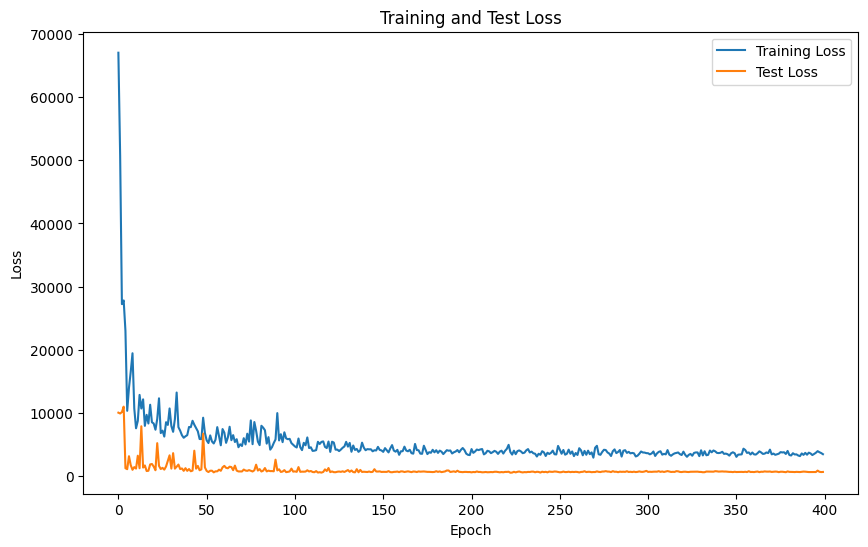

In [432]:
# Plot the training and test losses
plt.figure(figsize=(10, 6))
plt.plot(training_losses, label='Training Loss')
plt.plot(test_losses, label='Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Test Loss')
plt.legend()
plt.show()

In [433]:
model.eval()
with torch.no_grad():
    y_pred = model(torch.tensor(X_test.to_numpy(), dtype=torch.float32)).detach().numpy().flatten()
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('Neural Network')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

Neural Network
Mean Squared Error: 3122.0149795458065
Mean Absolute Error: 42.43701297019837
R^2 Score: 0.7989451678971986
[  93.97088867  -51.00186623  -37.7587054    87.244093     11.12390379
   31.79053877   13.51582554  -23.78899767   48.06297759 -109.17031499
   23.06402463   71.84199734   38.25091074   30.53290718   50.07271706
   15.33941589   20.61935425   56.86911639   36.85134391  -33.77052467
    6.29515348 -102.76556412 -119.10582413  -12.69662654  -32.9045829
    6.27479084  -93.3599674    52.43038214  -47.05632151  -24.02046042
   15.48823254  -76.76406835 -127.67075921  -26.05097359  -51.27319661
   -0.99083455   40.5983124   -84.09632888   43.87143012   13.69518048
   -9.63918356   -0.84089769    0.85796201   76.065538     69.7191271
  -15.26233926   43.46628442   32.90667891   36.21533325 -106.59557374
   59.4293245   -30.11723836  -90.95197502   36.32451242  100.96117533
 -109.79387207  -30.79170073  -66.7761072   -55.46245783   72.46885737
    6.38910929    7.7441126

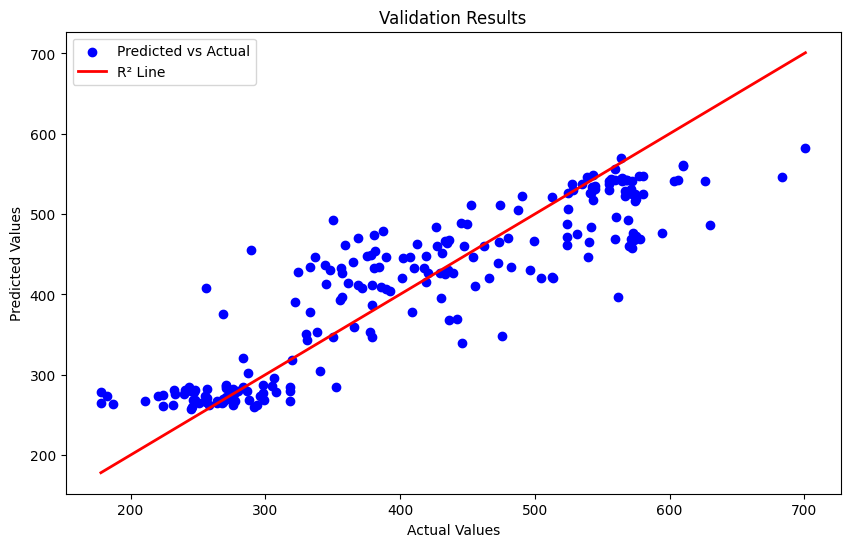

In [434]:
# Plot the predicted vs actual values
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()

In [435]:
torch.save(model.state_dict(), 'methane_model.pth')

## Grad Boost

In [436]:
# xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)
# xgb_model.fit(X_train, y_train)

# Param: 'colsample_bytree': 0.6, 'gamma': 0.1, 'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 300, 'reg_alpha': 0.1, 'reg_lambda': 1.0, 'subsample': 0.6
xgb_model = xgb.XGBRegressor(colsample_bytree=0.6, gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=300, reg_alpha=0.1, reg_lambda=1.0, subsample=0.6, objective='reg:squarederror', random_state=42)
xgb_model.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.6, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.1, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=300, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [437]:
y_pred_xgb = xgb_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred_xgb)
mae = mean_absolute_error(y_test, y_pred_xgb)
r2 = r2_score(y_test, y_pred_xgb)
print('XGBoost Regressor')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred_xgb - y_test.to_numpy())

XGBoost Regressor
Mean Squared Error: 2952.302937490163
Mean Absolute Error: 40.4110109841806
R^2 Score: 0.8098744639911862
[  94.40512329  -15.58304299  -17.06986263   52.87032896   -2.18124148
   15.32777022   29.63420323   -8.98839952   29.32707671  -89.72719976
    8.0561511   112.73143215   28.26439951   41.8180024    54.26094949
   20.35272155   11.73855591   63.02414568  -27.04300424  -21.48616188
   16.90819058   -1.76971451  -83.43022598  -39.4410113   -20.8443412
   43.50184162  -65.76536291   62.0412525   -85.16264475   -9.94666891
   52.51328747 -108.19512914  -94.47041131   -2.06238716   -7.08298055
  -11.17680867   35.35313417  -32.80259719   63.65899726    9.94814068
  -23.76778463  -10.39042772    4.29241025   63.7328201    82.4469103
   16.15184531   40.3702456    22.36682295   36.46777466  -19.52602418
   51.06933915   -5.36928304  -79.53324333   19.22990793   76.44144572
 -134.2149231   -19.5685562   -78.44419802  -89.5407049    87.76783809
   78.91227214  -15.381497

In [438]:
joblib.dump(xgb_model, 'xgb_model.pkl')

['xgb_model.pkl']

In [169]:
# Define the parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],  # Number of trees
    'max_depth': [3, 5, 7],  # Tree depth
    'learning_rate': [0.01, 0.1],  # Learning rate
    'subsample': [0.6, 1.0],  # Row sampling
    'colsample_bytree': [0.6, 1.0],  # Feature sampling
    'gamma': [0, 0.1, 0.3],  # Minimum loss reduction for a split
    'reg_alpha': [0.01, 0.1],  # L1 regularization
    'reg_lambda': [0.1, 1.0],  # L2 regularization
}

# Set up the GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    scoring='r2',
    cv=5,  # Cross-validation folds
    verbose=1,
    n_jobs=-1  # Use all CPU cores
)

# Perform the grid search
grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Score: {grid_search.best_score_}")

# Evaluate on validation set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f"Validation MSE: {mse}")

Fitting 5 folds for each of 864 candidates, totalling 4320 fits
Best Parameters: {'colsample_bytree': 0.6, 'gamma': 0.1, 'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 300, 'reg_alpha': 0.1, 'reg_lambda': 1.0, 'subsample': 0.6}
Best Score: 0.5617960133106091
Validation MSE: 4352.225200658874


In [170]:
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('XGBoost Regressor')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

XGBoost Regressor
Mean Squared Error: 4352.225200658874
Mean Absolute Error: 52.11238094440708
R^2 Score: 0.5274554214549627
[  -8.57121111   52.02411      30.59717108   20.73662867  -10.23860392
  -65.2412336    20.24016724  -19.49280221  103.14288976 -239.14330646
  -55.03625689  -79.71111002  -80.89114025   40.69071721    0.37582058
   79.55880956   76.7497653   109.14264119   59.66435907  -89.83121017
   15.17435533  -20.5907525    37.10322469   95.37046384  -20.07875444
   24.55659587  -65.54502631   21.17801514  -54.02655712  -14.54635378
   25.80993248 -212.57753634   27.68084357   43.48963826   30.95916858
  -40.40606586  -54.81261392  -38.08666337   77.43937478   40.09011718
    5.93022664   64.8516316    45.7620341    50.19204935  -36.47806464
    4.83637135    6.93760173   -8.69268858   83.05670573   99.08716386
  114.37757587   15.40561474   59.27929914   11.16140159  115.91111456
  -24.08164349  -20.78178988  -56.91319784   89.00371798  -62.48242439
    3.97724797  -11.792

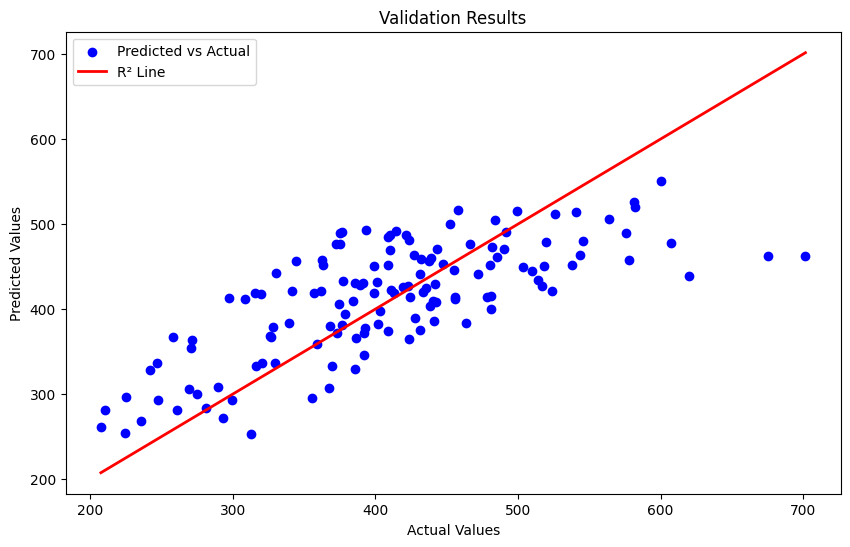

In [171]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()
plt.show()

In [439]:
# Clean column names
X_train.columns = X_train.columns.str.replace(r'[^\w\s]', '_', regex=True)
X_test.columns = X_test.columns.str.replace(r'[^\w\s]', '_', regex=True)
X_train.columns = X_train.columns.str.replace(r'\s+', '_', regex=True)
X_test.columns = X_test.columns.str.replace(r'\s+', '_', regex=True)

lightgbm_model = lgb.LGBMRegressor(random_state=42, objective='regression')
lightgbm_model.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8844
[LightGBM] [Info] Number of data points in the train set: 873, number of used features: 48
[LightGBM] [Info] Start training from score 410.470139


LGBMRegressor(objective='regression', random_state=42)

In [440]:
y_pred_lightgbm = lightgbm_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred_lightgbm)
mae = mean_absolute_error(y_test, y_pred_lightgbm)
r2 = r2_score(y_test, y_pred_lightgbm)
print('LightGBM Regressor')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred_lightgbm - y_test.to_numpy())

LightGBM Regressor
Mean Squared Error: 2925.156149474512
Mean Absolute Error: 38.71342149144587
R^2 Score: 0.8116226916397964
[ 1.27081836e+02 -3.23327973e+01 -3.53209958e+00  3.30609309e+01
 -2.15595909e+01  4.93704421e+01 -2.50921290e+00 -5.35472934e+00
  3.10270783e+01 -7.19314013e+01  1.16404672e+01  1.43372587e+02
  2.06960198e+01  4.12617121e+01  5.75312961e+01  8.53800633e+00
 -1.35729392e+01  5.45180627e+01 -4.08759999e+01 -5.66177801e+00
  4.90706761e+01 -5.29554311e+00 -1.51390862e+01 -2.19928294e+01
  1.98166340e+00  1.96125951e+01 -8.14117684e+01  4.05884070e+01
 -4.81236897e+01  1.28188435e+00  4.33346681e+01 -1.04401605e+02
 -9.58182963e+01  3.28957945e+01 -3.30556268e+01 -1.76276080e+01
  6.08273872e+00 -1.38437564e+01  4.14434785e+01  9.67989829e+00
 -1.16793362e+01 -1.18300320e+01  9.10634592e+00  4.82993628e+01
  5.36031447e+01  5.83187801e+01  2.45204124e+01  3.91733361e+01
  2.59832791e+01 -1.83265359e+01  4.33011246e+01 -2.19122893e+01
 -4.27458452e+01  2.32614724e

In [443]:
joblib.dump(lightgbm_model, 'lightgbm_model.pkl')

['lightgbm_model.pkl']

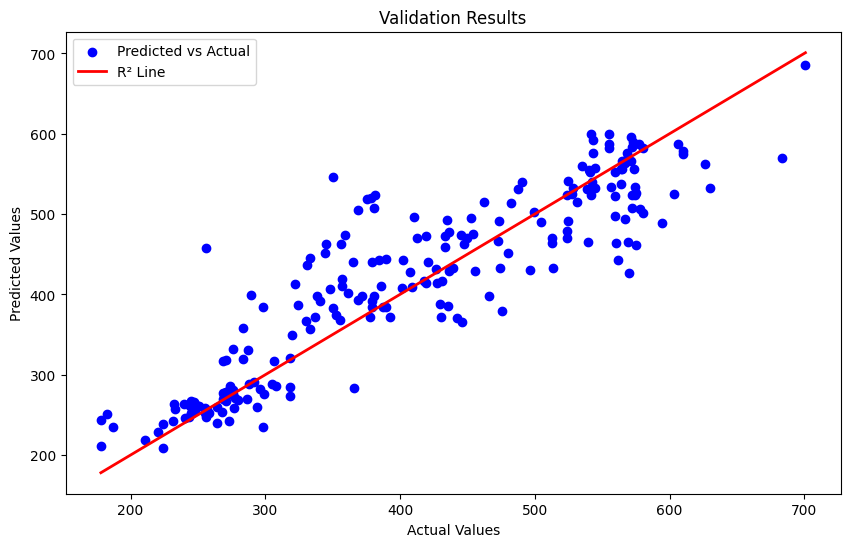

In [442]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_lightgbm, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')
plt.legend()
plt.show()

In [181]:
param_grid = {
    'num_leaves': [31, 50],            # The maximum number of leaves in one tree
    'max_depth': [-1, 10],              # Maximum depth of the tree
    'learning_rate': [0.01, 0.1],    # Step size shrinkage
    'n_estimators': [100, 200, 500],       # Number of boosting iterations
    'min_child_samples': [20, 50],     # Minimum number of data points in a leaf
    'subsample': [0.6, 1.0],          # Fraction of samples to be used for each tree
    'colsample_bytree': [0.6, 1.0]    # Fraction of features to be used for each tree
}

# Setup GridSearchCV
grid_search = GridSearchCV(
    estimator=lightgbm_model,
    param_grid=param_grid,
    cv=5,                       # 5-fold cross-validation
    scoring='r2',                # Using R² score
    verbose=1,
    n_jobs=-1                    # Use all cores
)

# Perform the grid search
grid_search.fit(X_train, y_train)

# Output the best parameters
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best cross-validation score (R²): {grid_search.best_score_}")

# Evaluate the model on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Calculate R² score on the test set
r2_test = r2_score(y_test, y_pred)
print(f"R² score on test data: {r2_test}")

Fitting 5 folds for each of 192 candidates, totalling 960 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008597 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6273
[LightGBM] [Info] Number of data points in the train set: 435, number of used features: 48
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002456 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6262
[LightGBM] [Info] Total Bins 6257
[LightGBM] [Info] Number of data points in the train set: 434, number of used features: 48
[LightGBM] [Info] Number of data points in the train set: 434, number of used features: 48
[LightGBM] [Info] Start training from score 415.777894
[LightGBM] [Info] Sta

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [182]:
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('LightGBM Regressor')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred - y_test.to_numpy())

LightGBM Regressor
Mean Squared Error: 4514.657167424948
Mean Absolute Error: 53.19011006297854
R^2 Score: 0.5098193061946366
[-2.92186432e+00  3.20292446e+01  3.54013207e+01  3.17413516e+01
  1.71808480e+01 -5.84830048e+01  2.78195762e+01 -3.40740284e+01
  1.01902285e+02 -2.48729264e+02 -6.72714121e+01 -7.86958677e+01
 -9.77301396e+01  3.63345185e+01 -1.96809794e+00  7.46353282e+01
  8.64559222e+01  1.05468174e+02  7.54688215e+01 -8.39806592e+01
 -3.31689067e-01 -3.93051395e+01  3.71107358e+01  8.77867109e+01
 -1.77831129e+01 -1.06396948e+01 -8.11980861e+01  1.73635857e+01
 -5.57494441e+01 -2.12959505e+01  2.74050802e+01 -2.07378320e+02
  3.00064977e+01  4.42362995e+01  2.75287809e+01 -5.33665891e+01
 -3.05202450e+01 -4.01936985e+01  7.38734699e+01  4.41049387e+01
  5.40163037e+00  9.91708659e+01  2.34209203e+01  6.21607303e+01
 -3.82228062e+00 -1.51229300e+01  2.51761578e+01  4.04728511e+00
  7.77020282e+01  1.06885798e+02  1.17196274e+02  1.78756289e+00
  4.52668386e+01  2.29232643e

Text(0.5, 1.0, 'Validation Results')

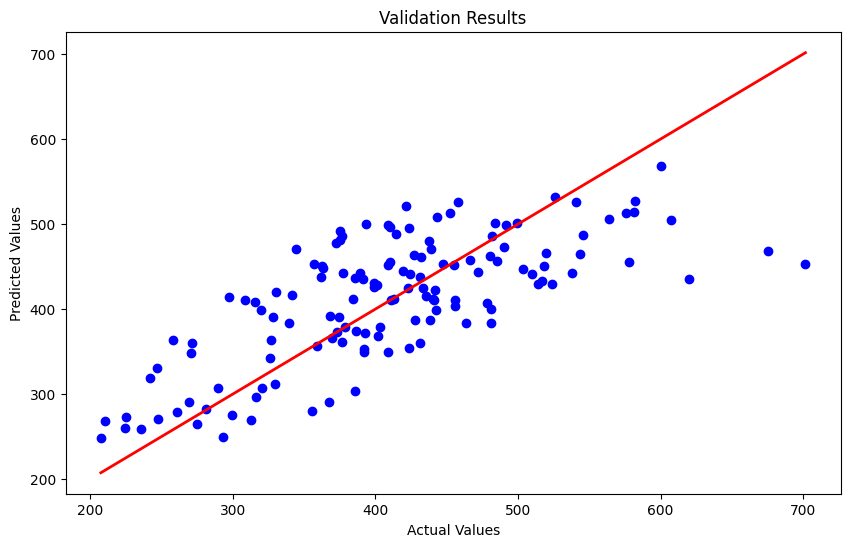

In [183]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, label='R² Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Validation Results')

## Guassian Process Regression

In [178]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C

kernel = C(10.0, (1e-3, 1e3)) * RBF(10, (1e-2, 1e2))
gp_model = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, random_state=42)
gp_model.fit(X_train, y_train)

/Users/wallacelee/miniforge3/envs/igem/lib/python3.12/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


GaussianProcessRegressor(kernel=3.16**2 * RBF(length_scale=10),
                         n_restarts_optimizer=10, random_state=42)

In [179]:
y_pred_gp = gp_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred_gp)
mae = mean_absolute_error(y_test, y_pred_gp)
r2 = r2_score(y_test, y_pred_gp)
print('Gaussian Process Regressor')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')
print(f'R^2 Score: {r2}')
print(y_pred_gp - y_test.to_numpy())

Gaussian Process Regressor
Mean Squared Error: 11574.892958295854
Mean Absolute Error: 82.0134861881753
R^2 Score: -0.25674859698294017
[  51.60182821  164.81763408   28.87060117  -27.19015323   -5.47157704
  -45.74377049 -136.27188004  -16.22678379   61.30560606 -211.1284114
 -231.09951886 -397.0771668   -85.73722945 -129.83567605  -37.21976494
   55.98980732 -118.93357917   21.30524391 -167.22693544 -163.9063014
   49.33773514  -43.14120211    6.1152189   -50.46718442   14.25021951
   21.57164353  -20.67848311  -59.89339757   68.30259756   61.64928694
   72.31097363 -167.45268115  -25.12784887 -117.61466481   18.39239918
    1.05413226  -60.40878046  -46.47793267  -42.94961805   58.76513723
 -201.73258634  -55.30707775   75.60174023   58.55384274 -141.3644494
  -44.43981599 -226.20940894   20.03424704   70.81689908  -75.41549047
   42.6497205  -227.970455     20.4195974    91.50610532  -69.7100799
 -113.02641285  -42.18047934 -138.12317788  140.86307095  -74.70334173
   -1.35212657  

## K Neighbour to predict Herd

In [218]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

X = methane_data.iloc[:, :5] 
X = StandardScaler().fit_transform(X)
herd_columns = herd_data.columns
herd_dict = {herd: i for i, herd in enumerate(herd_columns)}
methane_batch = herd_data[herd_columns].idxmax(axis=1)
methane_batch = methane_batch.map(herd_dict) 
y = methane_batch

In [219]:
# Count the 1s and 0s
herd_data.value_counts()

Herd IT1  Herd IT2  Herd IT3  Herd UK1  Herd UK2
0         0         0         1         0           243
1         0         0         0         0           184
0         1         0         0         0           176
          0         0         0         1           163
                    1         0         0            48
Name: count, dtype: int64

In [220]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

knn = KNeighborsClassifier(n_neighbors=5)

# Train the model
knn.fit(X_train, y_train)

# Predict on the test set
y_pred = knn.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print('K Nearest Neighbors')
print(f'Mean Squared Error: {mse}')
print(f'Mean Absolute Error: {mae}')

acc = accuracy_score(y_test, y_pred)
print(f'Accuracy: {acc}')

K Nearest Neighbors
Mean Squared Error: 1.0368098159509203
Mean Absolute Error: 0.3987730061349693
Accuracy: 0.803680981595092


In [221]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train) 
y_pca = knn.predict(X_train)

y_pred_pca = knn.predict(X_test)
X_test_pca = pca.transform(X_test)  

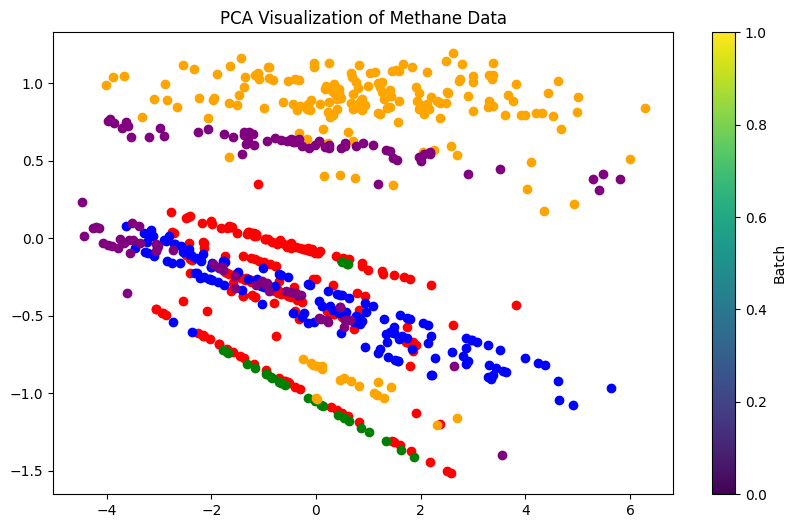

In [222]:
# ground truth
colors = ['red', 'blue', 'green', 'orange', 'purple']
plt.figure(figsize=(10, 6))
for i in range(5):
    plt.scatter(X_pca[y_pca == i, 0], X_pca[y_pca == i, 1], color=colors[i], label=f'Batch {i}')
plt.title('PCA Visualization of Methane Data')
plt.colorbar(label='Batch')
plt.show()

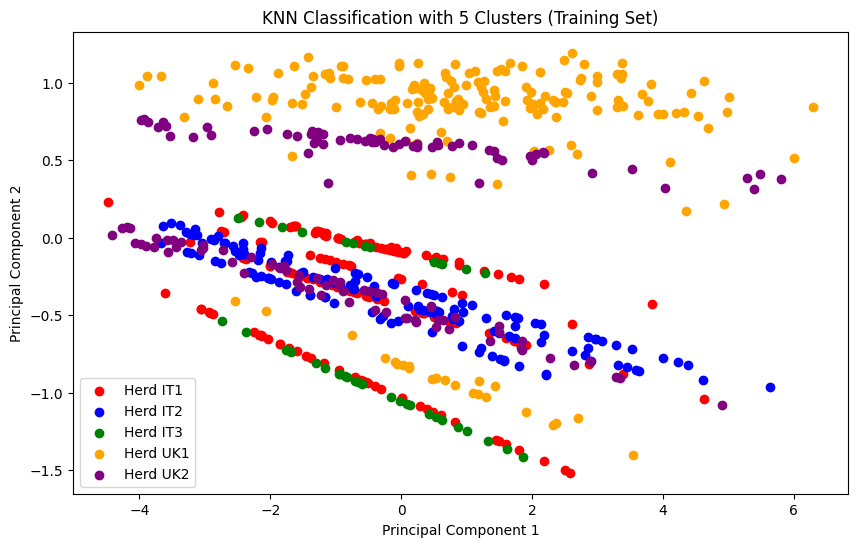

In [223]:
# Define the color map for 5 clusters (classes)
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Plot the predicted clusters for the training set
plt.figure(figsize=(10, 6))

for cluster in np.unique(y_train):
    plt.scatter(X_pca[y_train == cluster, 0], X_pca[y_train == cluster, 1], 
                label=f'{herd_columns[cluster]}', c=colors[cluster])

plt.title('KNN Classification with 5 Clusters (Training Set)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

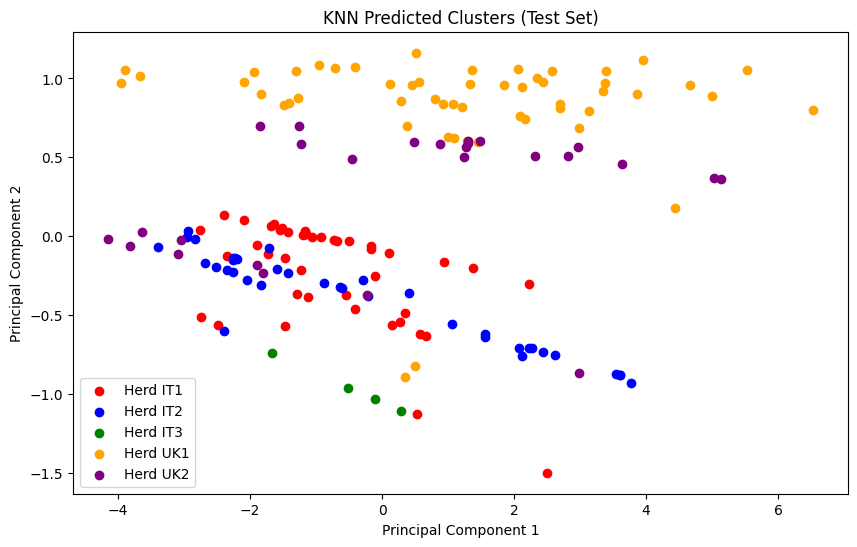

In [224]:
# Plot the predicted clusters for the test set
plt.figure(figsize=(10, 6))

for cluster in np.unique(y_pred_pca):
    plt.scatter(X_test_pca[y_pred_pca == cluster, 0], X_test_pca[y_pred_pca == cluster, 1], 
                label=f'{herd_columns[cluster]}', c=colors[cluster])

plt.title('KNN Predicted Clusters (Test Set)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

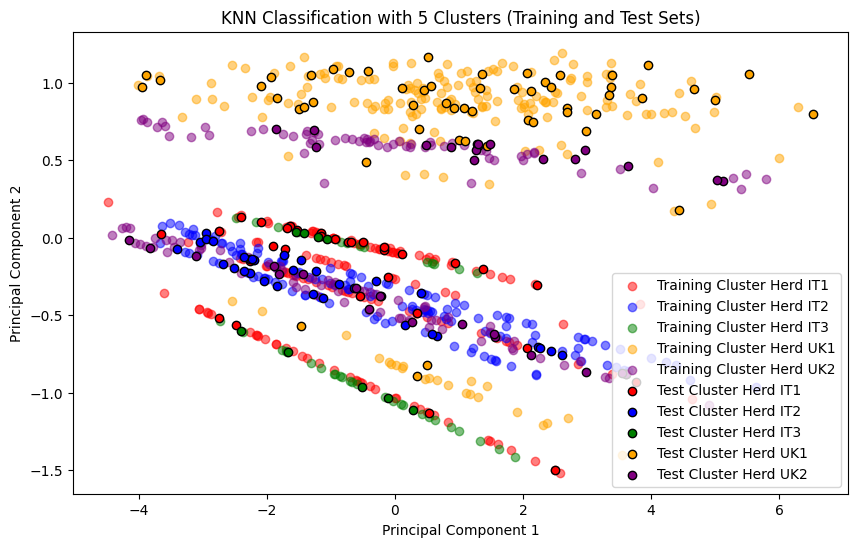

In [225]:
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Plot the training set with transparency (alpha)
plt.figure(figsize=(10, 6))
for cluster in np.unique(y_train):
    plt.scatter(X_pca[y_train == cluster, 0], X_pca[y_train == cluster, 1],
                label=f'Training Cluster {herd_columns[cluster]}', c=colors[cluster], alpha=0.5)

# Plot the test set with full opacity
for cluster in np.unique(y_test):
    plt.scatter(X_test_pca[y_test == cluster, 0], X_test_pca[y_test == cluster, 1],
                label=f'Test Cluster {herd_columns[cluster]}', c=colors[cluster], edgecolor='black')

# Add titles and labels
plt.title('KNN Classification with 5 Clusters (Training and Test Sets)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

In [226]:
import joblib
joblib.dump(knn, 'knn_model_herd.pkl')

['knn_model_herd.pkl']